In [1]:
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt

RGB
(512, 512)


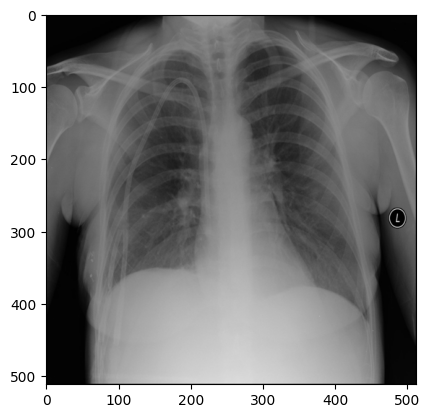

RGB
(512, 512)


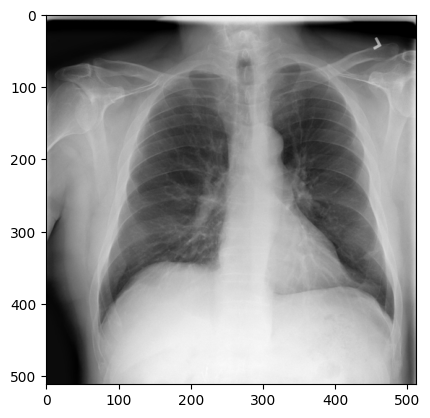

RGB
(512, 512)


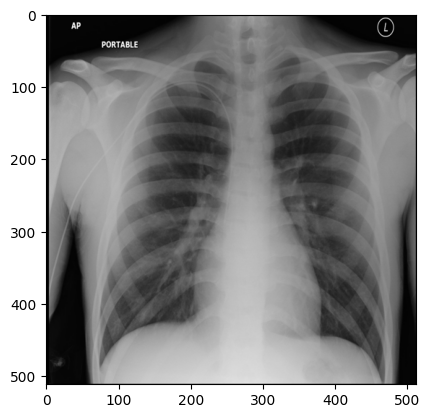

RGB
(512, 512)


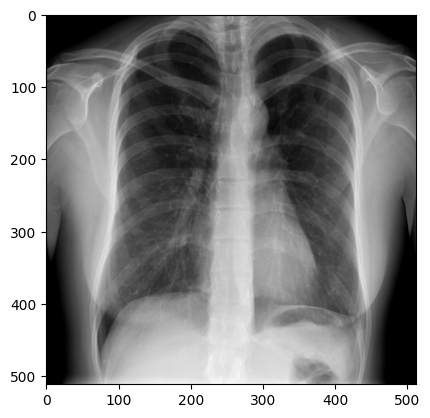

In [2]:
# range(start, stop, step)
for i in range(1,5):
    image = Image.open(
        f'../input/tuberculosis-tb-chest-xray-dataset/TB_Chest_Radiography_Database/Normal/Normal-{i}.png')
    print(image.mode)
    print(image.size)
    plt.imshow(image)
    plt.show()

In [3]:
### Software engineering Project Code

In [3]:
import numpy as np
from numpy import asarray
import os
from tqdm import tqdm

In [4]:
dir_path = '../input/tuberculosis-tb-chest-xray-dataset/TB_Chest_Radiography_Database/'

In [5]:
def numpize(subset: str, img_size=(128, 128), grayscale=False):
    """
    Convert a set of images from a specified subset to NumPy arrays.

    Parameters:
    - subset (str): Specifies the subset of images, e.g., 'Normal' or 'Tuberculosis'.
    - img_size (tuple): Tuple representing the desired size of the images after resizing.
    - grayscale (bool): If True, convert images to grayscale.

    Returns:
    - numpy_array (numpy.ndarray): NumPy array containing the transformed images.
    """
    image_dir = f'{dir_path}/{subset}/'
    image_files = os.listdir(image_dir)
    image_count = len(image_files)
    transformed_images = []

    for i in tqdm(range(1, image_count + 1), desc='Transforming...'):
        image_path = f'{image_dir}/{subset}-{i}.png'
        image = Image.open(image_path)

        # Ensure all images are in the same format
        if grayscale:
            image = image.convert('L')  # Convert to grayscale
        else:
            image = image.convert('RGB')  # Convert to RGB

        # Resize all images to the specified size without padding
        resized_image = image.resize(img_size)
        data = np.asarray(resized_image)
        transformed_images.append(data)

    numpy_array = np.array(transformed_images)
    return numpy_array

## Normal

In [6]:
norm = numpize(subset='Normal', 
               img_size=(128, 128), 
               grayscale=False)
norm.shape

Transforming...: 100%|██████████| 3500/3500 [01:06<00:00, 52.55it/s]


(3500, 128, 128, 3)

## Tuberculosis

In [7]:
tb = numpize(subset='Tuberculosis', 
             img_size=(128, 128), 
             grayscale=False)
tb.shape

Transforming...: 100%|██████████| 700/700 [00:12<00:00, 58.25it/s]


(700, 128, 128, 3)

In [8]:
target_norm = np.zeros(norm.shape[0])
print(f'Shape: {target_norm.shape[0]}, array: {target_norm}')

Shape: 3500, array: [0. 0. 0. ... 0. 0. 0.]


In [9]:
target_tb = np.ones(tb.shape[0])
print(f'Shape: {target_tb.shape[0]}, array: {target_tb}')

Shape: 700, array: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1

In [10]:
def show_image(images, target, title, num_display=16, num_cols=4, cmap='gray', random_mode=False):
    '''
    :Parameters
        images (ndarray (n,)): Input data as a numpy array.
        target (ndarray (n,)): Target data as a numpy array.
        title (String): Title of the plot.
        num_display (int): Number of images to display. Default is 16.
        num_cols (int): Number of columns in the plot. Default is 4.
        cmap (str): Color map for displaying images. Default is 'gray'.
        random_mode (bool): If True, display images randomly. If False, display the first num_display images. Default is False.
    '''
    # Determine the number of rows based on the num_cols parameter
    n_cols = min(num_cols, num_display)
    n_rows = int(np.ceil(num_display / n_cols))

    n_images = min(num_display, len(images))
    if random_mode:
        random_indices = np.random.choice(
            len(images), num_display, replace=False)
    else:
        random_indices = np.arange(num_display)

    fig, axes = plt.subplots(
        nrows=n_rows, ncols=n_cols, figsize=(20, 4*n_rows))
    for i, ax in enumerate(axes.flatten()):
        if i >= n_images:  # Check if the index exceeds the available number of images
            break
        # Incase (Did PCA)
        index = random_indices[i]
        if len(images.shape) == 2:
            image = images[index].reshape((128, 128)).astype(int)
        else:
            image = images[index]

        ax.imshow(image, cmap=cmap)
        ax.set_title("Target: {}".format(target[index]))

        # Add image index as text
        ax.text(0.5, -0.15, f'Image Index: {index}', transform=ax.transAxes,
                fontsize=10, ha='center')

    plt.suptitle(f"{title} (Displaying {num_display} Images)",
                 fontsize=16, fontweight='bold')

    fig.set_facecolor('white')
    plt.tight_layout() 
    return plt.show()

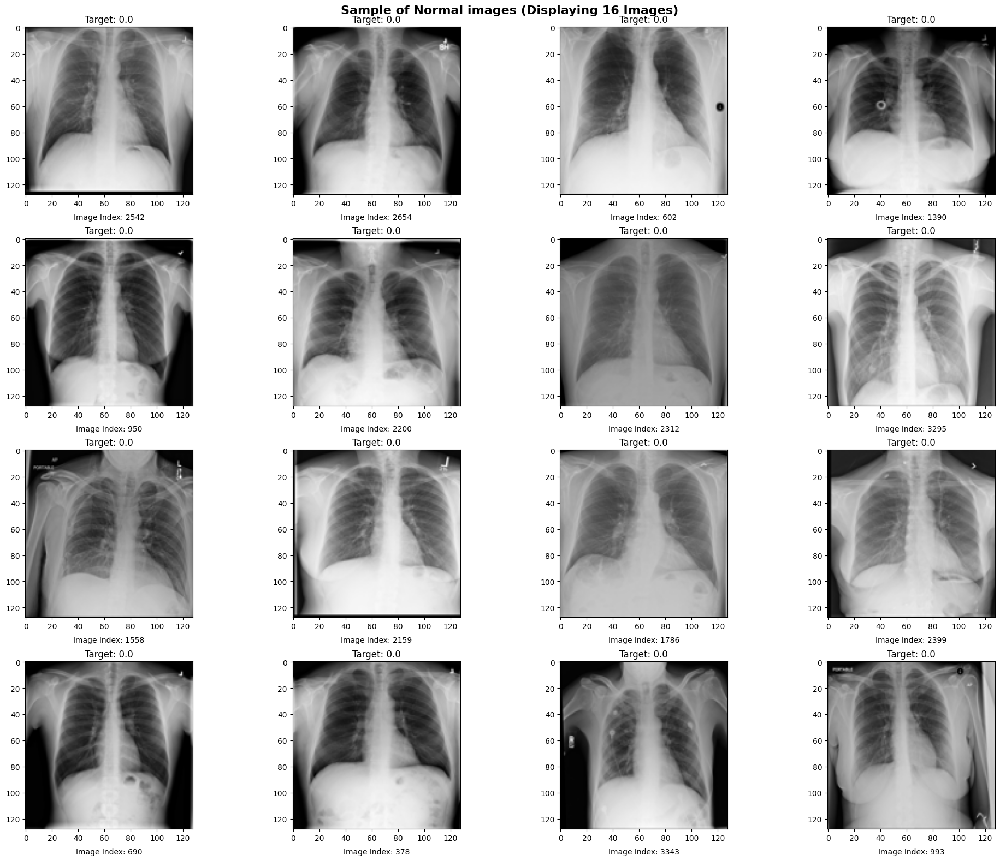

In [11]:
show_image(images=norm, 
           target=target_norm,
           title='Sample of Normal images',
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

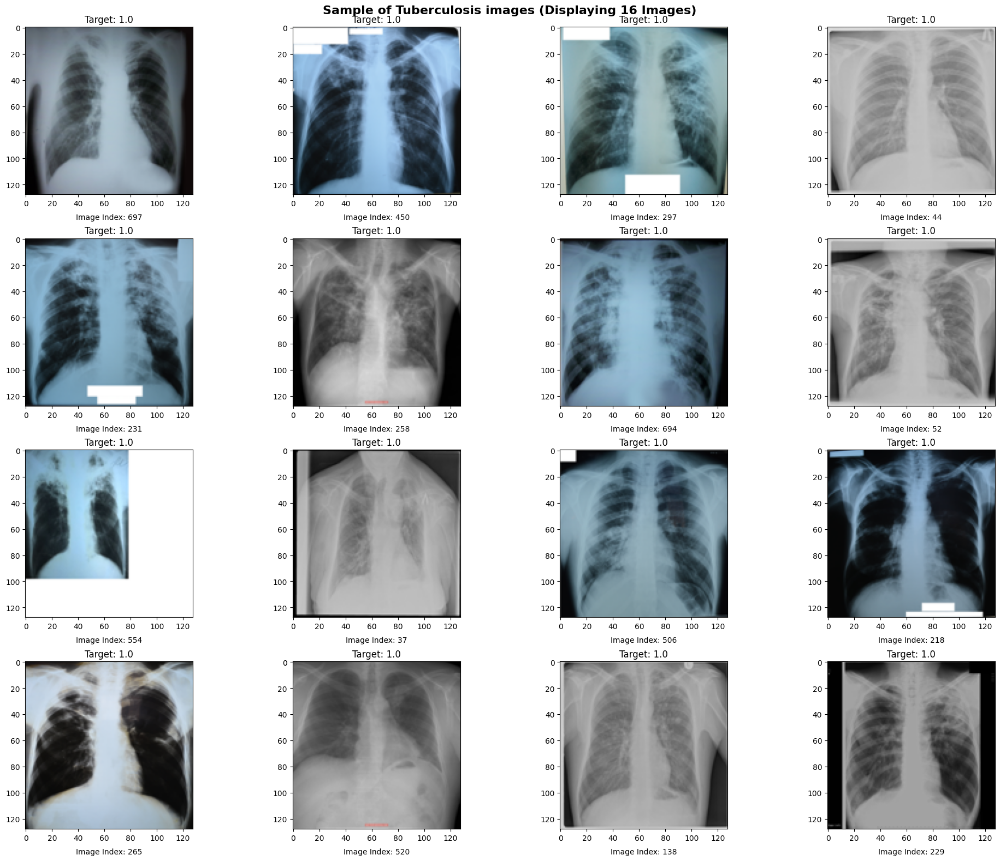

In [12]:
show_image(images=tb, 
           target=target_tb,
           title='Sample of Tuberculosis images',
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

In [13]:
from skimage import img_as_float
from skimage import exposure

In [14]:
def plot_gray_scale_histogram(images, titles, bins=100):
    '''
    Plot Gray Scale Histograms of Images.

    Parameters:
        - images (list): List of grayscale images to plot histograms for.
        - titles (list): List of titles for each histogram.
        - bins (int, optional): Number of bins for the histogram. Default is 100.

    Returns:
        None

    This function generates histograms for a list of grayscale images and displays them side by side. Each histogram is accompanied by its respective title.

    The function does not return any values; it displays the histogram plots directly.
    '''
    # Display results
    fig, axes = plt.subplots(2, len(images), figsize=(20, 8))

    for i, (title, image) in enumerate(zip(titles, images)):
        ax_img, ax_hist, ax_cdf, random_index = img_and_hist(
            image, axes[:, i], bins)

        mean_value = np.mean(image)
        std_value = np.std(image)
        min_value = np.min(image)
        max_value = np.max(image)

        ax_img.set_title('Random image of '+r'$\bf{' + f'{title}'+'}$' +
                         f'\nMean: {mean_value: .2f}, Std: {std_value: .2f}, Min: {min_value: .2f}, Max: {max_value: .2f}', fontsize=16)
        ax_img.text(0.5, -0.15, f'Image Index: {random_index}\n(Display random image)', transform=ax_img.transAxes,
                    fontsize=10, ha='center')

        y_min, y_max = ax_hist.get_ylim()
        ax_hist.set_title(
            'Distribution of pixel intensities of'+r'$\bf{' + f'{title}'+'}$', fontsize=16)
        ax_hist.set_ylabel('Number of pixels')
        ax_hist.set_yticks(np.linspace(0, y_max, 5))

        ax_cdf.set_ylabel('Fraction of total intensity')
        ax_cdf.set_yticks(np.linspace(0, 1, 5))

    plt.suptitle('Gray scale Histogram: Distribution of intensity pixel',
                 fontsize=16, fontweight='bold')
    # Prevent overlap of y-axis labels
    fig.tight_layout()
    plt.show()


def img_and_hist(image_data, axes, bins=100):
    '''
    Plot an image along with its histogram and cumulative histogram.

    Parameters:
        - image_data (ndarray): Grayscale image data as a numpy array.
        - axes (list): List of axes for displaying the image, histogram, and cumulative histogram.
        - bins (int): Number of bins for the histogram.

    Returns:
        - ax_img, ax_hist, ax_cdf: Axes objects for image, histogram, and cumulative histogram.

    This function displays an image along with its histogram and cumulative histogram. It takes the grayscale image data, a list of axes for plotting, and the number of bins for the histogram.

    The function returns the axes objects for the image, histogram, and cumulative histogram.
    '''

    '''
    Plot an image along with its histogram and cumulative histogram.
    '''
    image = img_as_float(image_data)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    random_index = np.random.randint(0, len(image_data))

    # Display image
    ax_img.imshow(image if image.shape[0] ==1 else image[random_index], cmap=plt.cm.gray)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')
    # ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # Display cumulative distribution
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf, random_index

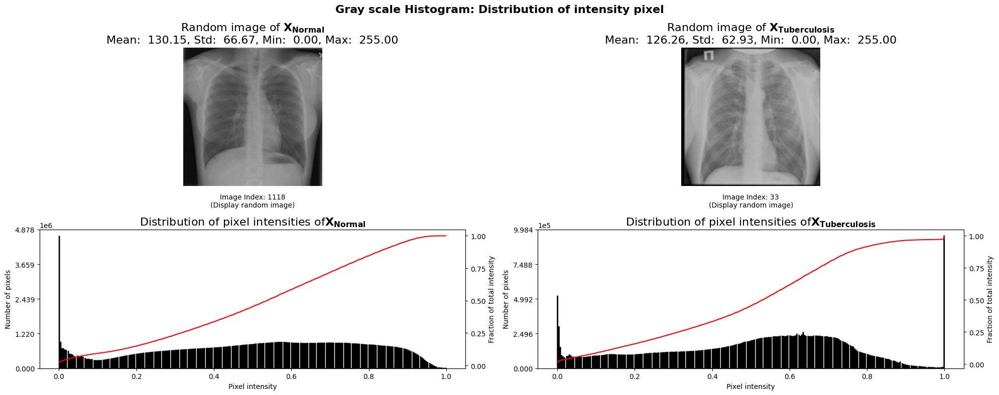

In [15]:
images = [norm, tb]
subsets = ['X_{Normal}', 'X_{Tuberculosis}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

In [16]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import random

In [17]:
def x_ray_image_augmentation(images, targets, sample_count):
    '''
    :Parameters
        df (ndarray (n,)): Input data as a numpy array.
        target (ndarray (n,)): Target data as a numpy array.
        sample_count (integer64): Number of data needed.
    '''

    # Randomize the data augmentation parameters
    rotation_range = random.randint(-5, 5)
    # width_shift_range = random.uniform(0.0, 0.05)      Not reccomend
    # height_shift_range = random.uniform(0.0, 0.05)     Not reccomend
    # shear_range = random.uniform(0.0, 0.1)             Not reccomend
    zoom_range = random.uniform(0.0, 0.1)
    fill_mode = random.choice(['nearest',
                               'constant',
                               #    'reflect',               Not reccomend
                               'wrap'])

    # Create the ImageDataGenerator with randomized parameters
    datagen = ImageDataGenerator(
        rotation_range=rotation_range,
        # width_shift_range=width_shift_range,             Not reccomend
        # height_shift_range=height_shift_range,           Not reccomend
        # shear_range=shear_range,                         Not reccomend
        zoom_range=zoom_range,
        fill_mode=fill_mode
    )
    # Load and augment the data

    augmented_data_generator = datagen.flow(images, targets, batch_size=1)
    batch_images, batch_labels = augmented_data_generator.next()
    for _ in tqdm(range(sample_count), desc='augmenting...'):
        batch_images, batch_labels = augmented_data_generator.next()
        try:
            combined_images = np.concatenate(
                (combined_images, batch_images), axis=0)
            combined_labels = np.concatenate(
                (combined_labels, batch_labels), axis=0)
        except NameError:
            combined_images = np.concatenate((images, batch_images), axis=0)
            combined_labels = np.concatenate((targets, batch_labels), axis=0)
    '''
    Returns:
        combined_images (ndarray (n,)) : generated images
        combined_labels (ndarray (n,)) : generated labels
    '''

    return combined_images, combined_labels


In [18]:
# Scaled the dataset before do Augmentation 
norm = norm/255
tb = tb/255

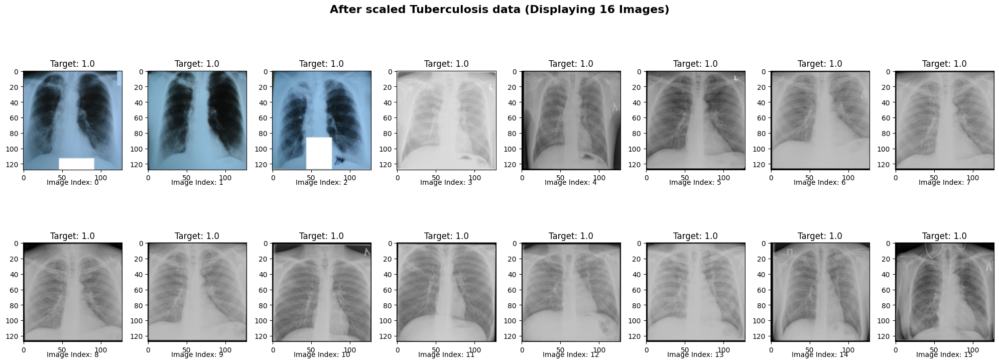

In [19]:
show_image(images=tb,
           target=target_tb,
           title='After scaled Tuberculosis data', 
           num_display=16, 
           num_cols=8, 
           cmap='gray', 
           random_mode=False)

In [20]:
tb_augmented, target_tb_augmented = x_ray_image_augmentation(images=tb, 
                                                             targets=target_tb, 
                                                             sample_count=2800)

augmenting...: 100%|██████████| 2800/2800 [15:01<00:00,  3.10it/s]


In [21]:
tb_augmented.shape

(3500, 128, 128, 3)

In [22]:
print(
    f'Before {tb.shape[0]}\nAfter Data Augmentation {tb_augmented.shape[0]}\n+{tb_augmented.shape[0]-tb.shape[0]} Training examples')

Before 700
After Data Augmentation 3500
+2800 Training examples


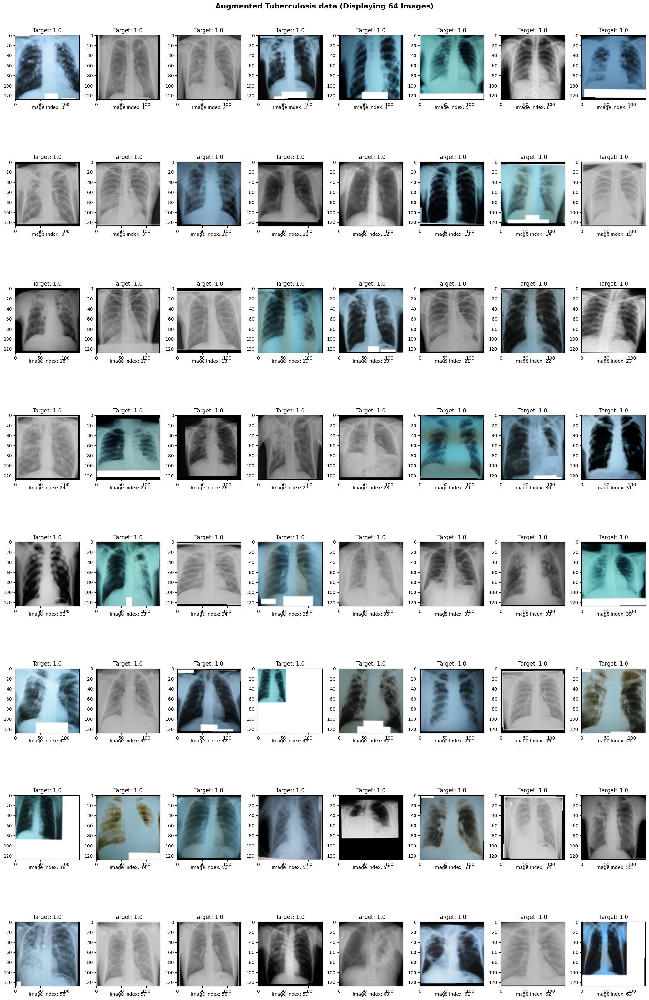

In [23]:
# Start index since 700 to last to observe to new training images
show_image(images=tb_augmented[700:-1],
           target=target_tb_augmented[700:-1],
           title='Augmented Tuberculosis data', 
           num_display=64, 
           num_cols=8, 
           cmap='gray', 
           random_mode=False)

### Compare Distribution (Tuberculosis Original Dataset vs Tuberculosis + Augmentation)

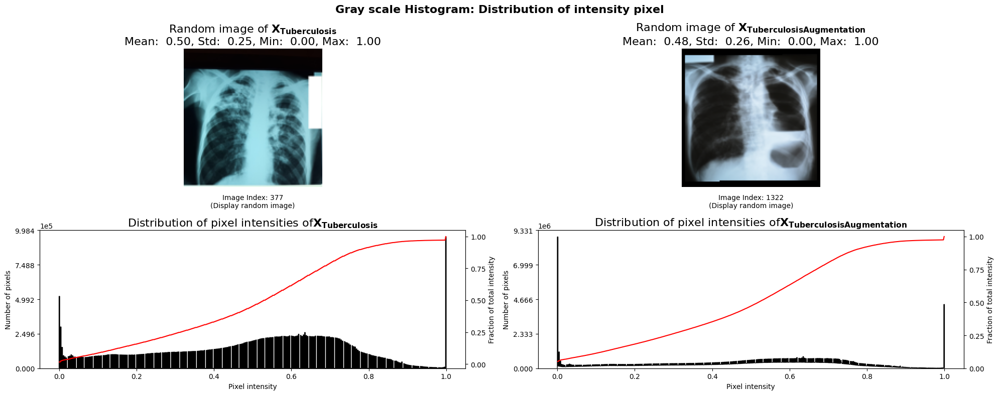

In [24]:
images_2 = [tb, tb_augmented]
subsets_2 = ['X_{Tuberculosis}', 'X_{TuberculosisAugmentation}']
# For visualization
plot_gray_scale_histogram(images=images_2, titles=subsets_2, bins=555)

In [25]:
# Concatenate df_norm and df_tb along the first axis (samples)
X = np.concatenate((norm, tb_augmented), axis=0)

# Concatenate target_norm and target_tb
y = np.concatenate((target_norm,  target_tb_augmented), axis=0)

In [26]:
X.shape

(7000, 128, 128, 3)

In [27]:
y.shape

(7000,)

In [28]:
import pandas as pd

In [29]:
y_df = pd.DataFrame(y)
y_df.value_counts()

0.0    3500
1.0    3500
Name: count, dtype: int64

Balanced dataset!

In [30]:
from skimage import exposure

In [31]:
def contrast_stretching(X):
    p2, p98 = np.percentile(X, (2, 98))
    stretched_img = exposure.rescale_intensity(X, in_range=(p2, p98))
    return stretched_img

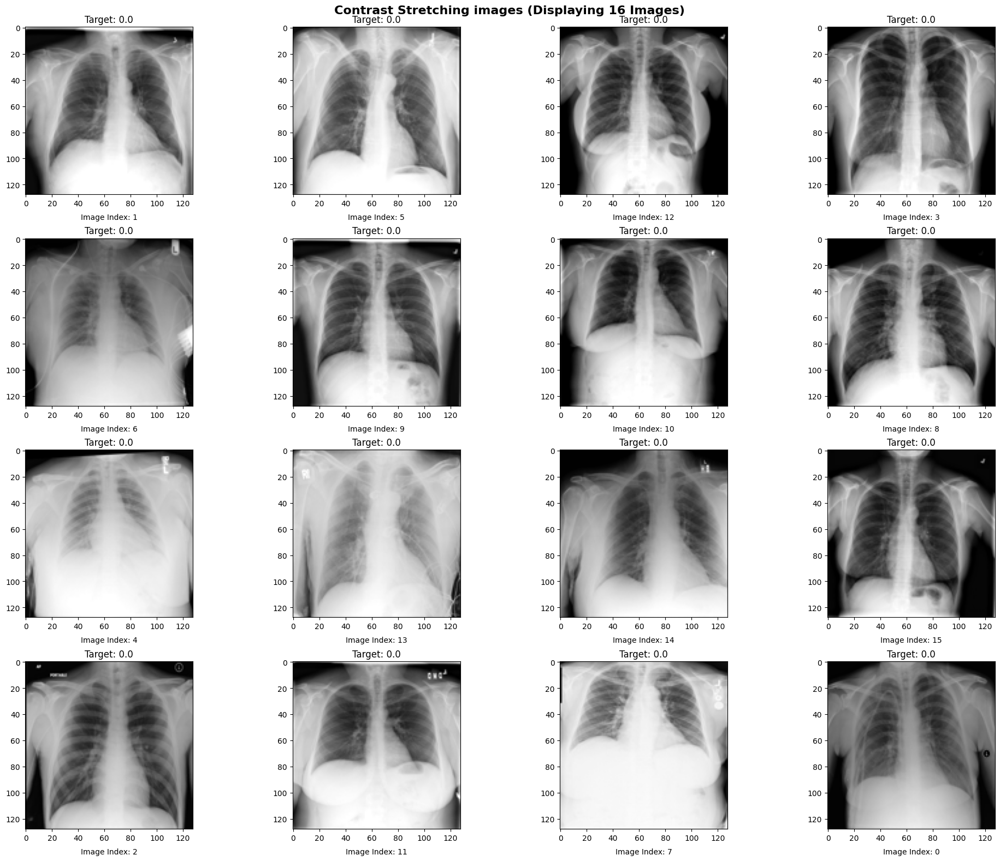

In [32]:
X_stretched = contrast_stretching(X[0:16])
show_image(images=X_stretched,
           target=y,
           title='Contrast Stretching images', 
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)

In [33]:
def equalization(X):
    eq_img = exposure.equalize_hist(X)
    return eq_img

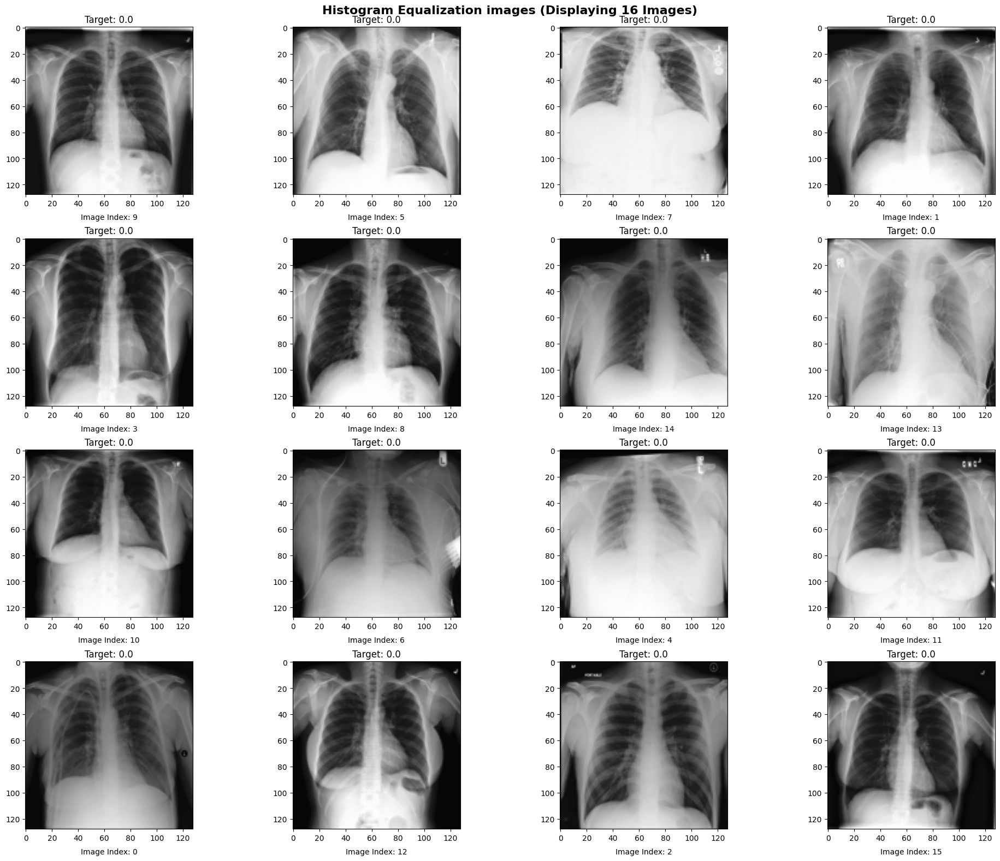

In [34]:
X_eq = equalization(X[0:16])
show_image(images=X_eq,
           target=y,
           title='Histogram Equalization images', 
           num_display=16, 
           num_cols=4, 
           cmap='gray', 
           random_mode=True)


def adaptive_equalization(X, clip_limit):
    '''
    :Parameters:
    X (ndarray (n,)): Input data as a numpy array, X.shape should be (128, 128, 1)
    clip_limit (int or float): used to control the contrast
    '''
    # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization
    X_normalized = (X - np.min(X)) / (np.max(X) - np.min(X))
    X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
    adapteq_img = exposure.equalize_adapthist(
        X_normalized, clip_limit=clip_limit)

    return adapteq_img

```

In [35]:
def adaptive_equalization(X, clip_limit, batch_size=None):
    '''
    :Parameters:
    X (ndarray (n,)): Input data as a numpy array, X.shape should be (128, 128, 1)
    clip_limit (int or float): used to control the contrast     
    batch_size (int): Size of the batch to process. If None, the entire input is processed at once.
    '''
    if batch_size is None:
        # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization
        X_normalized = (X - np.min(X)) / (np.max(X) - np.min(X))
        X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
        adapteq_img = exposure.equalize_adapthist(
            X_normalized, clip_limit=clip_limit)
    else:
        # Process data in batches
        num_batches = int(np.ceil(len(X) / batch_size))
        batch_results = []

        for i in tqdm(range(num_batches),desc='process...'):
            start_idx = i * batch_size
            end_idx = min((i + 1) * batch_size, len(X))

            # Normalize the input image to the range of -1 to 1 and perform adaptive histogram equalization for each batch
            X_normalized = (X[start_idx:end_idx] - np.min(X[start_idx:end_idx])) / \
                (np.max(X[start_idx:end_idx]) - np.min(X[start_idx:end_idx]))
            X_normalized = (X_normalized * 2) - 1  # Scale to -1 to 1
            adapteq_img_batch = exposure.equalize_adapthist(
                X_normalized, clip_limit=clip_limit)
            batch_results.append(adapteq_img_batch)

        # Concatenate the batch results
        adapteq_img = np.concatenate(batch_results, axis=0)

    return adapteq_img

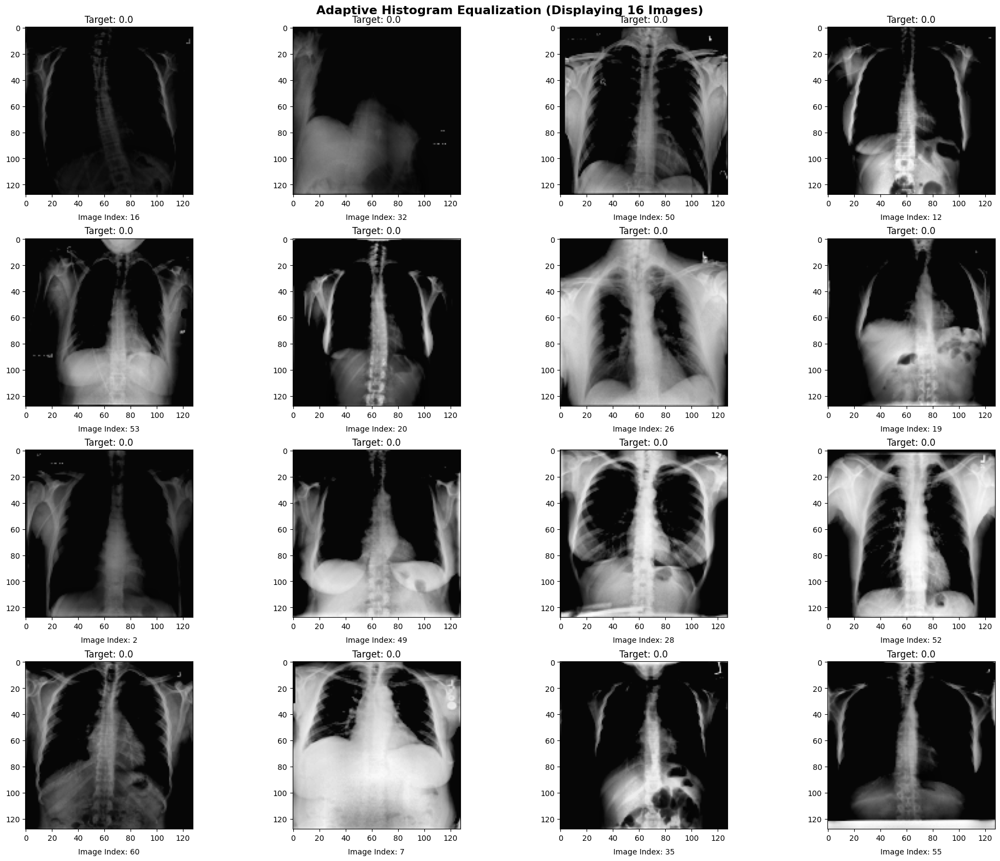

In [36]:
X_adapteq = adaptive_equalization(X[0:64],0.03)
show_image(images=X_adapteq,
            target=y,
            title='Adaptive Histogram Equalization', 
            num_display=16, 
            num_cols=4, 
            cmap='gray', 
            random_mode=True)

###Summary of each image enhancement 

In [37]:
sample = X[0,:,:,:]
sample.shape

(128, 128, 3)

In [38]:
# 1. Load a normal image
img = sample

# 2. Contrast stretching
img_cs = contrast_stretching(img)

# 3. Histogram Equalization
img_eq = equalization(img)

# 4. Adaptive Equalization
img_adapteq = adaptive_equalization(img, 0.03)

methods = ['Low contrast image', 'Contrast stretching',
           'Histogram equalization', 'Adaptive equalization']
images_3 = [img, img_cs, img_eq, img_adapteq]

/opt/conda/lib/python3.10/site-packages/skimage/_shared/utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


In [39]:
def img_and_hist_single_img(image, axes, bins=100):
    '''
    Plot an image along with its histogram and cumulative histogram.
    '''
    image = img_as_float(image)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # Display image
    ax_img.imshow(image, cmap=plt.cm.gray)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')
    # ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # Display cumulative distribution
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf

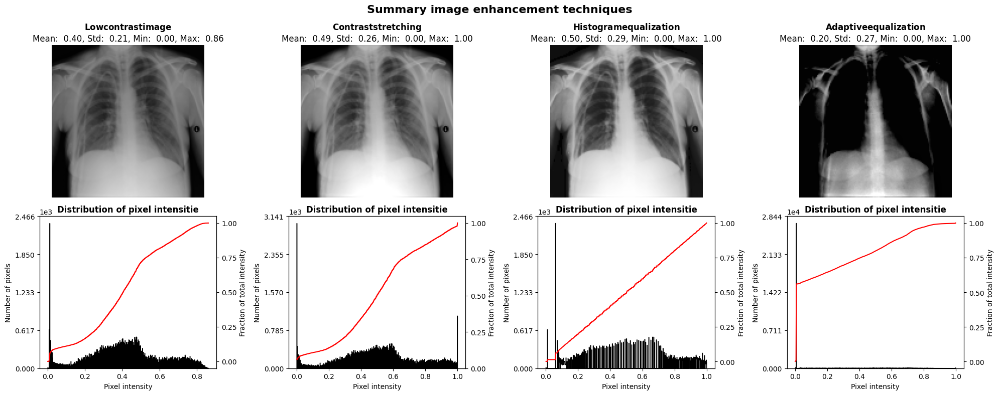

In [40]:
# Display results
fig, axes = plt.subplots(2, 4, figsize=(20, 8))

for i, (method, image) in enumerate(zip(methods, images_3)):
    ax_img, ax_hist, ax_cdf = img_and_hist_single_img(image, axes[:, i], bins=555)

    mean_value = np.mean(image)
    std_value = np.std(image)
    min_value = np.min(image)
    max_value = np.max(image)

    ax_img.set_title(
        r'$\bf{' + f'{method}'+'}$'+f'\nMean: {mean_value: .2f}, Std: {std_value: .2f}, Min: {min_value: .2f}, Max: {max_value: .2f}', fontsize=12)

    y_min, y_max = ax_hist.get_ylim()
    ax_hist.set_title(
        'Distribution of pixel intensitie', fontsize=12, fontweight='bold')
    ax_hist.set_ylabel('Number of pixels')
    ax_hist.set_yticks(np.linspace(0, y_max, 5))

    ax_cdf.set_ylabel('Fraction of total intensity')
    ax_cdf.set_yticks(np.linspace(0, 1, 5))

plt.suptitle('Summary image enhancement techniques',
             fontsize=16, fontweight='bold')
fig.tight_layout()
plt.show()

Table representing the architecture of the CNN model 

| Layer (Type)   | Number of Filters | Padding | Activation | Out of Activation Shape | Total Parameters            |
|-----------------|-------------------|---------|------------|--------------------------|-----------------------------|
| Input           | -                 | -       | -          | (128, 128, 1)            | 0                           |
| Conv2D          | 32 * unit_size_rate| Same    | ReLU       | (128, 128, 32)           | 320 * unit_size_rate        |
| MaxPooling2D    | -                 | Same    | -          | (64, 64, 32)             | 0                           |
| Conv2D          | 64 * unit_size_rate| Same    | ReLU       | (64, 64, 64)             | 18,496 * unit_size_rate     |
| MaxPooling2D    | -                 | Same    | -          | (32, 32, 64)             | 0                           |
| Conv2D          | 128 * unit_size_rate| Same    | ReLU       | (32, 32, 128)            | 73,856 * unit_size_rate     |
| MaxPooling2D    | -                 | Same    | -          | (16, 16, 128)            | 0                           |
| Flatten         | -                 | -       | -          | (32768)                  | 0                           |
| Dense           | 128 * unit_size_rate| -      | ReLU       | (128)                    | 4,194,560 * unit_size_rate |
| Dropout         | -                 | -       | -          | (128)                    | 0                           |
| Dense           | 1                 | -       | Sigmoid    | (1)                      | 129                         |

Total Params: 4,287,361 * unit_size_rate

In [41]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, Flatten, Dropout, Dense

In [42]:
class CNN:
    def __init__(self, 
                 input_shape=(128, 128, 3), 
                 unit_size_rate=0.05, 
                 conv_padding='same', 
                 conv_kernel_size=(3, 3),
                 conv_stride=1, 
                 pool_padding='same', 
                 pool_kernel_size=(2, 2), 
                 pool_stride=2, 
                 dropout=0, 
                 l1_lambda=None,
                 l2_lambda=None, 
                 pooling_type='max', 
                 epochs=5, 
                 batch_size=64, 
                 verbose=1):
        self.input_shape = input_shape
        self.unit_size_rate = unit_size_rate
        self.conv_padding = conv_padding
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.pool_padding = pool_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.dropout = dropout
        self.l1_lambda = l1_lambda
        self.l2_lambda = l2_lambda
        self.pooling_type = pooling_type
        self.epochs = epochs
        self.batch_size = batch_size
        self.verbose = verbose
        self.model = self.build_model()

    def build_model(self):
        reg_l1 = None
        reg_l2 = None

        if self.l1_lambda is not None:
            reg_l1 = tf.keras.regularizers.l1(self.l1_lambda)

        if self.l2_lambda is not None:
            reg_l2 = tf.keras.regularizers.l2(self.l2_lambda)

        if len(self.input_shape) == 2:
            # Add color channel for grayscale images
            self.input_shape = self.input_shape + (1,)

        model = Sequential()
        model.add(Conv2D(
            int(32 * self.unit_size_rate),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            activation='relu',
            kernel_regularizer=reg_l1,
            input_shape=self.input_shape))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Conv2D(
            int(64 * self.unit_size_rate),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            kernel_regularizer=reg_l2,
            activation='relu'))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Conv2D(
            int(128 * self.unit_size_rate),
            self.conv_kernel_size,
            strides=self.conv_stride,
            padding=self.conv_padding,
            kernel_regularizer=reg_l2,
            activation='relu'))

        if self.pooling_type == 'max':
            model.add(MaxPooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        elif self.pooling_type == 'avg':
            model.add(AveragePooling2D(
                pool_size=self.pool_kernel_size,
                strides=self.pool_stride,
                padding=self.pool_padding))
        else:
            raise ValueError("Invalid pooling_type. Use 'max' or 'avg'.")

        model.add(Flatten())
        model.add(Dense(
            units=int(128 * self.unit_size_rate),
            activation='relu',
            kernel_regularizer=reg_l2))

        model.add(Dropout(self.dropout))
        model.add(Dense(units=1, activation='sigmoid'))
        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
        return model

    def predict(self, X, threshold=0.5, verbose=0):
        return (self.model.predict(X, verbose=verbose) > threshold).astype("int32")

    def summary(self):
        self.model.summary()

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size, verbose=1):
        history = self.model.fit(
            X_train, y_train,
            batch_size=batch_size if batch_size else self.batch_size,
            epochs=epochs if epochs else self.epochs,
            verbose=verbose,
            validation_data=(X_val, y_val)
        )
        return history

In [43]:
cnn = CNN(unit_size_rate=1,
          input_shape=(128,128,3))

In [44]:
cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 64, 64, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 16, 16, 128)       0

# Splitting the Dataset:
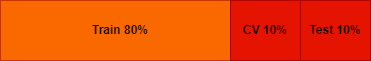

Split the dataset into training, validation, and test sets. The usual split ratios are 
- 80% for training, 
- 10% for validation, 
- and 10% for testing. 
Ensure that the classes are balanced in each split.

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
def viz_class_distribution(X, y, title, classe_labels, train_percent=0.6, val_percent=0.2, test_percent=0.2):
    '''
    :Parameters:
    - X (numpy array): The input feature matrix of shape (num_examples, num_features).
    - y (numpy array): The target labels of shape (num_examples,).
    - title (str): The title for the entire plot.
    - classes (list): A list of class labels, e.g., ['Normal', 'Tuberculosis'].
    - train_percent (float): Percentage of data for training set.
    - val_percent (float): Percentage of data for validation set.
    - test_percent (float): Percentage of data for test set.

    :Returns:
    - X_train, y_train, X_test, y_test, X_val, y_val: The subsets of the data.
    '''
    assert train_percent + val_percent + test_percent == 1.0, "Sum of train_percent, val_percent, and test_percent should be 1.0"

    # Convert y to integers
    y = y.astype(int)

    # Split the data
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y, test_size=val_percent + test_percent, random_state=42, stratify=y)

    test_size = test_percent / (val_percent + test_percent)
    X_val, X_test, y_val, y_test = train_test_split(
        X_temp, y_temp, test_size=test_size, random_state=42, stratify=y_temp)

    # Create a subplot with 3 columns and 1 row
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # List of subset names
    subset_names = ['Train', 'Test', 'Validation']
    n = len(X)

    # Iterate over subsets
    for i, subset in enumerate([(X_train, y_train), (X_test, y_test), (X_val, y_val)]):
        X_subset, y_subset = subset
        n_subset = len(y_subset)
        # Get the class counts
        class_counts = np.bincount(y_subset)

        # Plot histogram for the current subset
        axs[i].bar(classe_labels, class_counts, color='#AA99FF')
        subtitle = r'$\bf{' + subset_names[i] + \
            '}$' + f' {int(n_subset/n*100)} %'
        axs[i].set_title(
            subtitle + f'\n Size = {X_subset.shape[0]}', fontsize=18)
        axs[i].set_xlabel('Class')
        axs[i].set_ylabel('Number of examples')

        # Add labels to the bars
        for j, count in enumerate(class_counts):
            axs[i].text(j, count, str(count), ha='center',
                        va='bottom', fontsize=12)

    class_counts = np.bincount(y)
    class_balance_text = ' | '.join(
        [f'{class_label} ({count})' for class_label, count in zip(classe_labels, class_counts)])
    plt.suptitle(f'{title}' + f'\n Training examples (X): {X.shape[0]}' +
                 f'\nTarget (y): {class_balance_text}', fontsize=20)

    plt.tight_layout()
    plt.show()

    return X_train, y_train, X_test, y_test, X_val, y_val

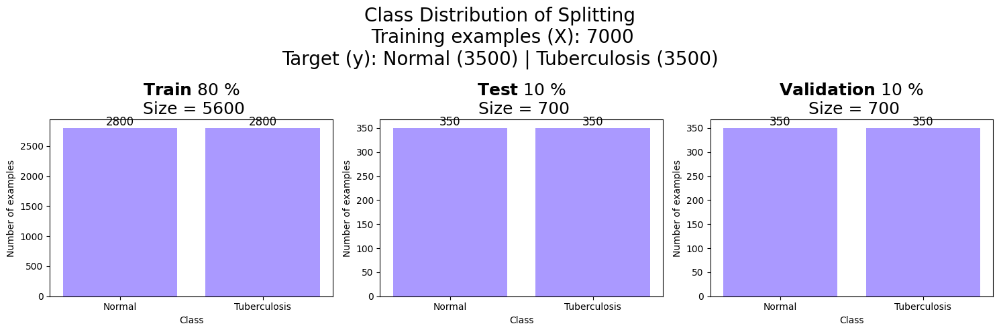

In [47]:
X_train, y_train, X_test, y_test, X_val, y_val = viz_class_distribution(X=X, 
                        y=y, 
                        title='Class Distribution of Splitting', 
                        classe_labels=['Normal', 'Tuberculosis'], 
                        train_percent=0.8, 
                        val_percent=0.1, 
                        test_percent=0.1)

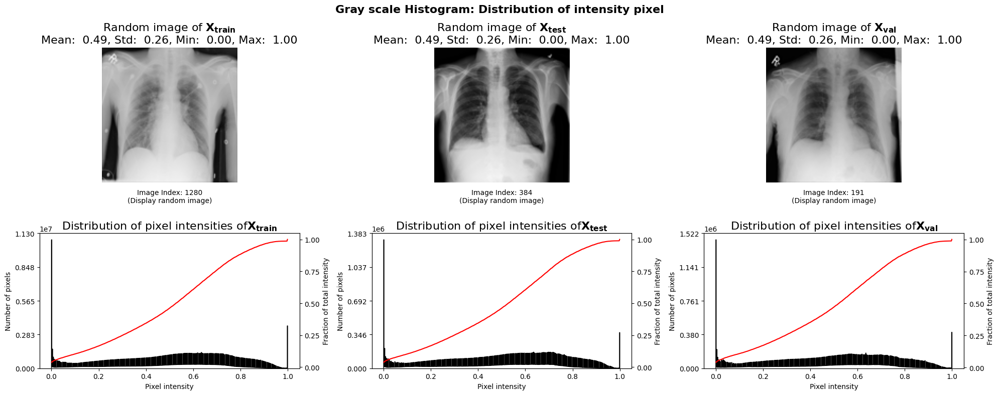

In [48]:
images = [X_train, X_test, X_val]
subsets = ['X_{train}', 'X_{test}', 'X_{val}']
# For visualization
plot_gray_scale_histogram(images=images, titles=subsets, bins=555)

#  Modeling

In [49]:
model_config = {
    # (height, width, channels)
    'input_shape': (128, 128,3),
    'unit_size_rate': 0.05,
    'l1_lambda': None,
    'l2_lambda': None,

    'conv_padding': 'same',
    'conv_kernel_size': (3, 3),
    'conv_stride': 1,

    'pool_padding': 'same',
    'pool_kernel_size': (2, 2),
    'pool_stride': 2,
    
    'dropout': 0,
    'pooling_type': 'max'
}

# Build model
model_1st = CNN(**model_config).build_model()
model_1st.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 128, 128, 1)       28        
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 64, 64, 1)         0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 64, 64, 3)         30        
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 32, 32, 3)         0         
 g2D)                                                            
                                                                 
 conv2d_8 (Conv2D)           (None, 32, 32, 6)         168       
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 16, 16, 6)        

In [50]:
import time

In [51]:
optimizer = tf.keras.optimizers.Adam()
optimizer_config= optimizer.get_config()
optimizer_config

{'name': 'Adam',
 'weight_decay': None,
 'clipnorm': None,
 'global_clipnorm': None,
 'clipvalue': None,
 'use_ema': False,
 'ema_momentum': 0.99,
 'ema_overwrite_frequency': None,
 'jit_compile': False,
 'is_legacy_optimizer': False,
 'learning_rate': 0.001,
 'beta_1': 0.9,
 'beta_2': 0.999,
 'epsilon': 1e-07,
 'amsgrad': False}

In [52]:
start_time = time.time()
# verbose is progress bar; verbose = 1 display, verbose = don't display 
verbose = 1
# Compile the model
model_1st.compile(loss='binary_crossentropy',
                   optimizer=optimizer,
                   metrics='accuracy')

# Train the model
history = model_1st.fit(X_train, y_train, 
                             epochs=30,
                             batch_size=64,
                             validation_data=(X_val, y_val),
                             verbose=verbose)

end_time = time.time()
training_time = end_time - start_time
training_time

Epoch 1/30
88/88 [==============================] - 24s 251ms/step - loss: 0.5994 - accuracy: 0.6400 - val_loss: 0.2745 - val_accuracy: 0.8886
Epoch 2/30
88/88 [==============================] - 19s 210ms/step - loss: 0.2709 - accuracy: 0.8900 - val_loss: 0.2158 - val_accuracy: 0.9286
Epoch 3/30
88/88 [==============================] - 18s 203ms/step - loss: 0.2196 - accuracy: 0.9204 - val_loss: 0.2130 - val_accuracy: 0.9343
Epoch 4/30
88/88 [==============================] - 18s 205ms/step - loss: 0.1850 - accuracy: 0.9346 - val_loss: 0.1829 - val_accuracy: 0.9414
Epoch 5/30
88/88 [==============================] - 18s 204ms/step - loss: 0.1699 - accuracy: 0.9411 - val_loss: 0.1729 - val_accuracy: 0.9457
Epoch 6/30
88/88 [==============================] - 18s 206ms/step - loss: 0.1600 - accuracy: 0.9434 - val_loss: 0.1653 - val_accuracy: 0.9471
Epoch 7/30
88/88 [==============================] - 18s 209ms/step - loss: 0.1424 - accuracy: 0.9525 - val_loss: 0.1620 - val_accuracy: 0.9471

563.5360436439514

In [53]:
print(f'Training time in minutes: {training_time/60:.2f} minutes')

Training time in minutes: 9.39 minutes


In [54]:
get_config = {
            'Optimizer parameters Configuration': {
                'optimizer_name': optimizer_config['name'],
                'learning_rate': optimizer_config['learning_rate'],
                'beta1': optimizer_config['beta_1'],
                'beta2': optimizer_config['beta_2'],
                'epsilon': optimizer_config['epsilon'],
            },
            'Hyperparameters Configuration': {
                'conv_padding': model_config['conv_padding'],
                'conv_kernel_size': model_config['conv_kernel_size'],
                'conv_stride': model_config['conv_stride'],
                'pool_padding': model_config['pool_padding'],
                'pool_kernel_size': model_config['pool_kernel_size'],
                'pool_stride': model_config['pool_stride'],
                'pooling_type': model_config['pooling_type'],
            },
            'Model Architecture Configuration': {
                'input_shape': model_config['input_shape'],
                'unit_size_rate': model_config['unit_size_rate']
            },
            'Model Training Configuration': {
                'batch_size': 20,
                'epoch': 64
            },
        }
get_config

{'Optimizer parameters Configuration': {'optimizer_name': 'Adam',
  'learning_rate': 0.001,
  'beta1': 0.9,
  'beta2': 0.999,
  'epsilon': 1e-07},
 'Hyperparameters Configuration': {'conv_padding': 'same',
  'conv_kernel_size': (3, 3),
  'conv_stride': 1,
  'pool_padding': 'same',
  'pool_kernel_size': (2, 2),
  'pool_stride': 2,
  'pooling_type': 'max'},
 'Model Architecture Configuration': {'input_shape': (128, 128, 3),
  'unit_size_rate': 0.05},
 'Model Training Configuration': {'batch_size': 20, 'epoch': 64}}

In [55]:
def get_history(history,
                model,
                training_time:float, 
                ref_name:str, 
                title:str):

        best_epoch = np.argmax(history.history['val_accuracy'])
        best_train_epoch = np.argmax(history.history['accuracy'])

        # Create a 1x2 grid of subplots
        fig, axes = plt.subplots(1, 2, figsize=(24, 15))

        # Plot training and validation accuracy
        axes[0].plot(history.epoch, history.history['accuracy'],
                     label='Train Accuracy')
        axes[0].plot(history.epoch, history.history['val_accuracy'],
                     label='Validation Accuracy')
        axes[0].scatter(best_epoch, history.history['val_accuracy']
                        [best_epoch], color='r', label='Best Epoch (Validation)')
        axes[0].scatter(best_train_epoch, history.history['accuracy']
                        [best_train_epoch], color='g', label='Best Epoch (Train)')

        # Annotate the best validation accuracy point
        best_accuracy = history.history['val_accuracy'][best_epoch]
        random_offset_x = 10
        random_offset_y = np.random.randint(-30, 30)
        axes[0].annotate(f'{best_accuracy:.3f}',
                         xy=(best_epoch, best_accuracy),
                         xytext=(random_offset_x, random_offset_y),
                         textcoords='offset points',
                         arrowprops=dict(arrowstyle='->'))

        axes[0].set_xlabel('Epoch')
        axes[0].set_ylabel('Accuracy (%)')
        axes[0].set_title('Training and Validation Accuracy')
        axes[0].legend()

        # Annotate the best training accuracy point
        best_train_accuracy = history.history['accuracy'][best_train_epoch]
        random_offset_y = np.random.randint(-30, 30)
        axes[0].annotate(f'{best_train_accuracy:.3f}',
                         xy=(best_train_epoch, best_train_accuracy),
                         xytext=(random_offset_x, random_offset_y),
                         textcoords='offset points',
                         arrowprops=dict(arrowstyle='->'))

        # Plot training and validation loss
        axes[1].plot(history.epoch,
                    history.history['loss'], label='Train Loss')
        axes[1].plot(history.epoch, history.history['val_loss'],
                     label='Validation Loss')
        axes[1].scatter(best_epoch, history.history['val_loss']
                        [best_epoch], color='r', label='Best Epoch (Validation)')
        axes[1].scatter(best_train_epoch,history.history['loss']
                        [best_train_epoch], color='g', label='Best Epoch (Train)')
        axes[1].set_xlabel('Epoch')
        axes[1].set_ylabel('Loss')
        axes[1].set_title('Training and Validation Loss')
        axes[1].legend()

        # Annotate the best validation loss point
        best_loss = history.history['val_loss'][best_epoch]
        random_offset_y = np.random.randint(-30, 30)
        axes[1].annotate(f'{best_loss:.3f}',
                         xy=(best_epoch, best_loss),
                         xytext=(random_offset_x, random_offset_y),
                         textcoords='offset points',
                         arrowprops=dict(arrowstyle='->'))

        # Annotate the best training loss point
        best_train_loss = history.history['loss'][best_train_epoch]
        random_offset_y = np.random.randint(-30, 30)
        axes[1].annotate(f'{best_train_loss:.3f}',
                         xy=(best_train_epoch, best_train_loss),
                         xytext=(random_offset_x, random_offset_y),
                         textcoords='offset points',
                         arrowprops=dict(arrowstyle='->'))

        # Calculate best validation accuracy in percentage
        best_accuracy_percentage = round(best_accuracy * 100, 2)

        # String for performance, accuracy, and training time
        minutes = int(training_time // 60)
        seconds = int(training_time % 60)

        # model summary
        stringlist = []
        model.summary(print_fn=lambda x: stringlist.append(x))
        short_model_summary = "\n".join(stringlist)

        # Set the text for the parameters on the right side
        performance = r'$\bf{' + f'Ref. name: {ref_name}' + '}$' + f"\nBest Validation Accuracy: {best_accuracy_percentage}%" + \
            f"\nBest Train Accuracy: {history.history['accuracy'][best_train_epoch] * 100:.2f}%" + \
            f", Training Time: {minutes} minutes {seconds} seconds"
        fig.suptitle(r'$\bf{' + title + '}$' +
                     '\n' + performance, fontsize=18)

        fig.text(1.05, 1.00, r'$\bf{' + 'Config Parameters:' + '}$', fontsize=16,
                 color='black', ha='left', transform=plt.gcf().transFigure)

        y_coord = 0.98  # Initial y-coordinate

        # Set the line height between each parameter group and each parameter within a group
        line_height = 0.028

        for group, params in get_config.items():
            fig.text(1.05, y_coord, r'$\bf{' + f'{group}:' + '}$', fontsize=14,
                     color='black', ha='left', transform=plt.gcf().transFigure)
            y_coord -= line_height

            for key, value in params.items():
                fig.text(1.05, y_coord, f"{key}: {value}", fontsize=12,
                         color='black', ha='left', transform=plt.gcf().transFigure)
                y_coord -= line_height

        fig.text(1.05, 0.01, r'$\bf{' + f'Model Summary:' + '}$' + f'\n{short_model_summary}',
                 fontsize=10, color='black', ha='left', transform=plt.gcf().transFigure)

        plt.tight_layout()
        plt.show()

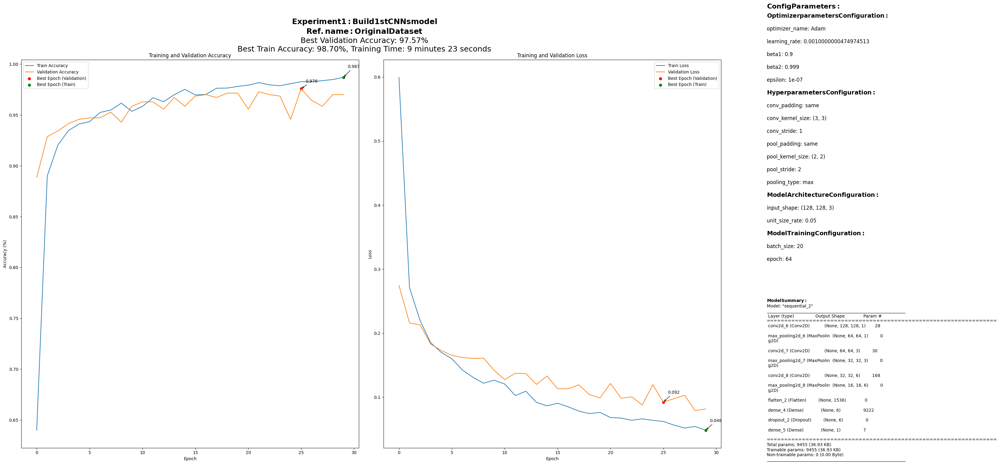

In [56]:
title = 'Experiment 1: Build 1st CNNs model'
get_history(history=history,
            model=model_1st,
            training_time=training_time, 
            title=title, 
            ref_name='Original Dataset')

#  Evaluation

In [57]:
import json
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, accuracy_score, roc_curve, roc_auc_score, f1_score

In [58]:
 def evaluate(estimator_name, estimator, X, y_actual, subset_name, training_time, threshold=None):

        # Model Prediction/Y hat
        y_pred = estimator.predict(
            X) 
        # Handling Output Layer of Activation='sigmoid'
        threshold = threshold if threshold else 0.5
        y_pred_binary = (y_pred > threshold).astype(int).flatten()

        # Calculate ROC curve and AUC score
        fpr, tpr, thresholds = roc_curve(y_actual, y_pred_binary)
        auc_score = roc_auc_score(y_actual, y_pred_binary)
        # Classification Report
        report = classification_report(
            y_actual, y_pred_binary, output_dict=True)
        report_dict = json.loads(json.dumps(report))

        # Extract precision and recall from report_dict
        precision = report_dict['weighted avg']['precision']
        recall = report_dict['weighted avg']['recall']
        accuracy = report_dict['accuracy']
        f1 = report_dict['weighted avg']['f1-score']

        # Confusion Matrix
        cm = confusion_matrix(y_actual, y_pred_binary)
        TP = cm[0][0]
        FP = cm[0][1]
        FN = cm[1][0]
        TN = cm[1][1]
        total_seconds = training_time
        minutes = int(training_time // 60)
        seconds = int(training_time % 60)
        training_time_ = "{} minutes {} seconds".format(minutes, seconds)

        accuracy_train = history.history['accuracy']
        accuracy_val = history.history['val_accuracy']

        performance_info = {
            'Model': estimator_name,
            'accuracy_train': accuracy_train,
            'accuracy_val': accuracy_val,
            'Subset': subset_name,
            'Training time': training_time_,
            'Training in seconds': total_seconds,
            'TP': TP,
            'FP': FP,
            'FN': FN,
            'TN': TN,
            'Precision': precision,
            'Recall': recall,
            'F1': f1,
            'AUC': auc_score,
            'Accuracy': accuracy,
        }
        return pd.DataFrame([performance_info])

##  Training set Performance 

In [59]:
evaluate(estimator_name='CNN', 
         estimator=model_1st, 
         X=X_train, 
         y_actual=y_train, 
         subset_name='Training', 
         training_time=training_time
         )

175/175 [==============================] - 8s 44ms/step


,Model,accuracy_train,accuracy_val,Subset,Training time,Training in seconds,TP,FP,FN,TN,Precision,Recall,F1,AUC,Accuracy
0,CNN,"[0.6399999856948853, 0.8899999856948853, 0.920...","[0.8885714411735535, 0.9285714030265808, 0.934...",Training,9 minutes 23 seconds,563.536044,2747,53,14,2786,0.98813,0.988036,0.988035,0.988036,0.988036


##  Test set Performance 

In [60]:
evaluate(estimator_name='CNN', 
         estimator=model_1st, 
         X=X_test, 
         y_actual=y_test, 
         subset_name='Test', 
         training_time=training_time
         )

22/22 [==============================] - 1s 41ms/step


,Model,accuracy_train,accuracy_val,Subset,Training time,Training in seconds,TP,FP,FN,TN,Precision,Recall,F1,AUC,Accuracy
0,CNN,"[0.6399999856948853, 0.8899999856948853, 0.920...","[0.8885714411735535, 0.9285714030265808, 0.934...",Test,9 minutes 23 seconds,563.536044,341,9,4,346,0.981527,0.981429,0.981428,0.981429,0.981429


In [61]:
def plot_confusion_matrix(y_actual, y_pred, subset_name):
    y_pred_binary = (y_pred > 0.5).astype(int).flatten()
    cm = confusion_matrix(y_actual, y_pred_binary)
    labels = ['Negative', 'Positive']

    # Extract TP, TN, FP, FN
    tn, fp, fn, tp = cm.ravel()
    sensitivity = tp / (tp + fn)  # Sensitivity or True Positive Rate
    specificity = tn / (tn + fp)  # Specificity or True Negative Rate

    plt.figure(figsize=(18, 9))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)



    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix - {subset_name}\n'
              f'True Positives: {tp} | True Negatives: {tn}\n'
              f'False Positives: {fp} (Type I error) | False Negatives: {fn} (Type II error)\n'
              f'Sensitivity (True Positive Rate): {sensitivity:.4f} | Specificity (True Negative Rate): {specificity:.4f}',
              loc='center', wrap=True)
    plt.show()

In [62]:
y_pred_test = model_1st.predict(X_test)

22/22 [==============================] - 1s 42ms/step


##  Confusion matrix

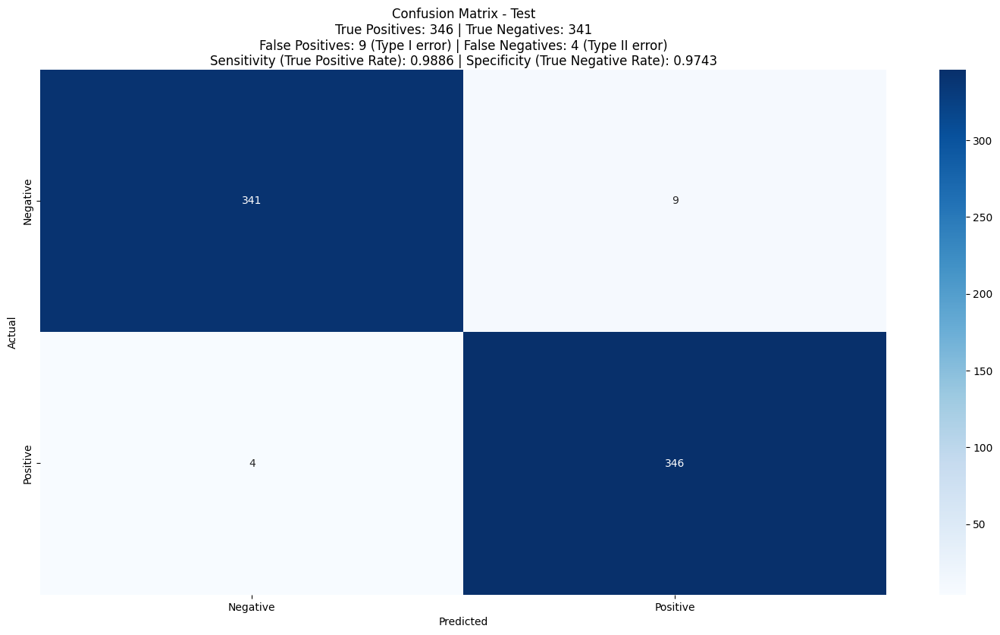

In [63]:
plot_confusion_matrix(y_actual=y_test, 
                      y_pred=y_pred_test, 
                      subset_name='Test')

## ROC

In [64]:
def plot_roc(y_actual, y_pred, subset_name):
    fpr, tpr, thresholds = roc_curve(y_actual, y_pred)
    # Print ROC Curve
    plt.figure(figsize=(18, 9))
    plt.plot(fpr, tpr, marker='o', linestyle='-',)
    plt.xlabel('False positive rate (1-Specificity)')
    plt.ylabel('True positive rate (Sensitivity)')
    plt.title(f'ROC Curve - {subset_name}')
    plt.grid()
    plt.show()

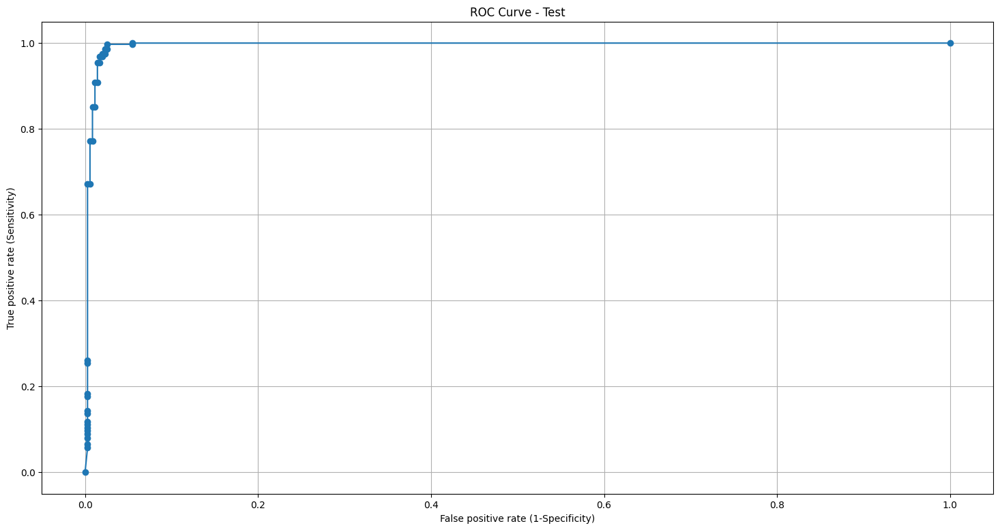

In [65]:
plot_roc(y_actual=y_test, y_pred=y_pred_test, subset_name='Test')

#  Different Image Input Sizes


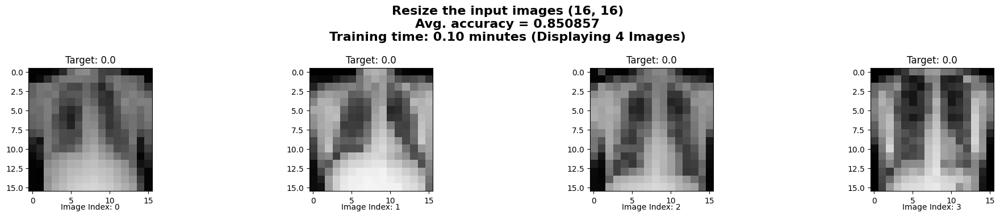

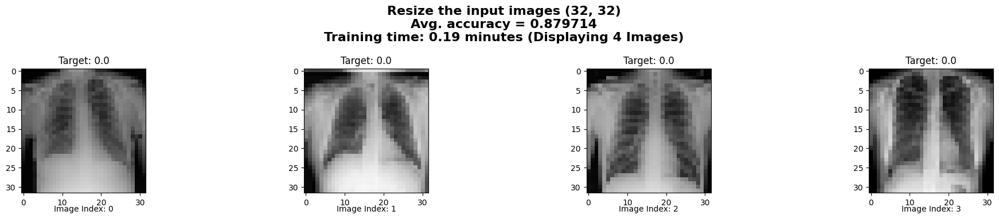

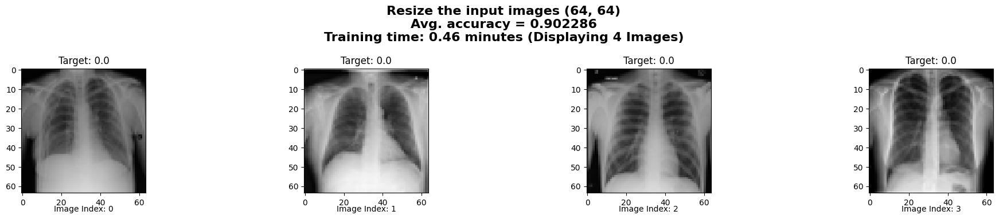

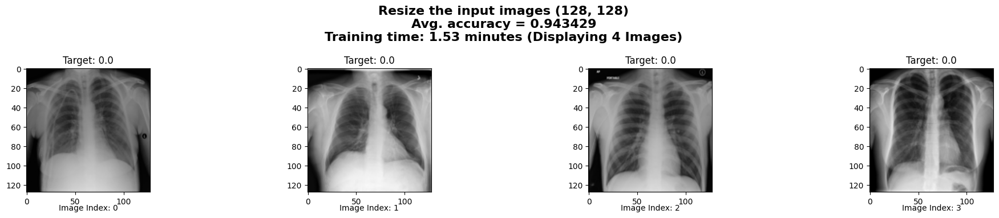

In [66]:
target_shapes = [(16, 16),(32, 32), (64, 64), (128, 128)]
for target_shape in target_shapes:
    X_resized = tf.image.resize(X, target_shape).numpy()
    model_config = {
        # (height, width, channels)
        'input_shape': target_shape +(3,),
        'unit_size_rate': 0.05,
        'l1_lambda': None,
        'l2_lambda': None,

        'conv_padding': 'same',
        'conv_kernel_size': (3, 3),
        'conv_stride': 1,

        'pool_padding': 'same',
        'pool_kernel_size': (2, 2),
        'pool_stride': 2,

        'dropout': 0,
        'pooling_type': 'max'
    }

    # Build model
    model = CNN(**model_config)

    X_train, X_temp, y_train, y_temp = train_test_split(
    X_resized, y, test_size=0.2, random_state=42, stratify=y)

    X_test, X_val, y_test, y_val = train_test_split(
        X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)
    # Train the model
    start_time = time.time()

    history = model.train(X_train, y_train, X_val, y_val,
                                 epochs=5,
                                 batch_size=64,
                                 verbose=0)
    end_time = time.time()
    training_time = end_time - start_time
    mean_acc = np.mean(history.history['val_accuracy'])
    show_image(images=X_resized, target=y,
               title=f'Resize the input images {target_shape}\nAvg. accuracy = {mean_acc:2f}\nTraining time: {training_time/60:.2f} minutes', 
               num_display=4, 
               num_cols=4, 
               random_mode=False)

#  Model Prediction

In [67]:
def compare_actual_and_predicted_xray(estimator, images, target, title, num_display=16, num_cols=4, random_mode=False):
    '''
    Compare Actual X-ray Images with Model Predictions.

    Parameters:
        estimator: Model used for predictions.
        images (ndarray): Input data as a numpy array.
        target (ndarray): Target data as a numpy array.
        title (str): Title of the plot.
        num_display (int, optional): Number of images to display. Default is 16.
        num_cols (int, optional): Number of columns in the plot. Default is 4.
        random_mode (bool, optional): If True, display images randomly. If False, display the first num_display images. Default is False.

    Returns:
        None

    This function generates a visual comparison between actual X-ray images and their corresponding model predictions. It displays a grid of images with labels to show whether the model's predictions match the actual target values. The grid is organized in rows and columns based on the specified parameters.

    The function does not return any values; it displays the comparison plot directly.
    '''

    n_cols = min(num_cols, num_display)
    n_rows = int(np.ceil(num_display / n_cols))

    title = r'$\bf{' + "Actual-Image" + '}$' + " vs " + \
        r'$\bf{' + "Model-Prediction" + '}$'
    y_hat = estimator.predict(images)
    prediction = (y_hat > 0.5).astype(int).flatten()

    n_images = min(num_display, len(images))
    if random_mode:
        random_indices = np.random.choice(
            len(images), num_display, replace=False)
    else:
        random_indices = np.arange(num_display)

    fig, axes = plt.subplots(
        nrows=n_rows, ncols=n_cols, figsize=(20, 4*n_rows))
    for i, ax in enumerate(axes.flatten()):
        if i >= n_images:  # Check if the index exceeds the available number of images
            break
        # Incase (Did PCA)
        index = random_indices[i]
        if len(images.shape) == 2:
            image = images[index].reshape((128, 128)).astype(int)
        else:
            image = images[index]
        actual_label = target[index]
        model_pred_label = prediction[index]
        model_prob = '{:.3f}'.format(float(y_hat[index]))
        ax.imshow(
            image, cmap='gray' if actual_label == model_pred_label else 'OrRd')
        ax.set_title(
            f"Actual: {actual_label},\nModel Prediction: {model_pred_label}\nProbability: {model_prob}")
    plt.suptitle(f"{title} (Displaying {num_display} Images)",
                 fontsize=16, fontweight='bold')

    fig.set_facecolor('white')
    plt.tight_layout()  
    plt.show()

22/22 [==============================] - 1s 41ms/step


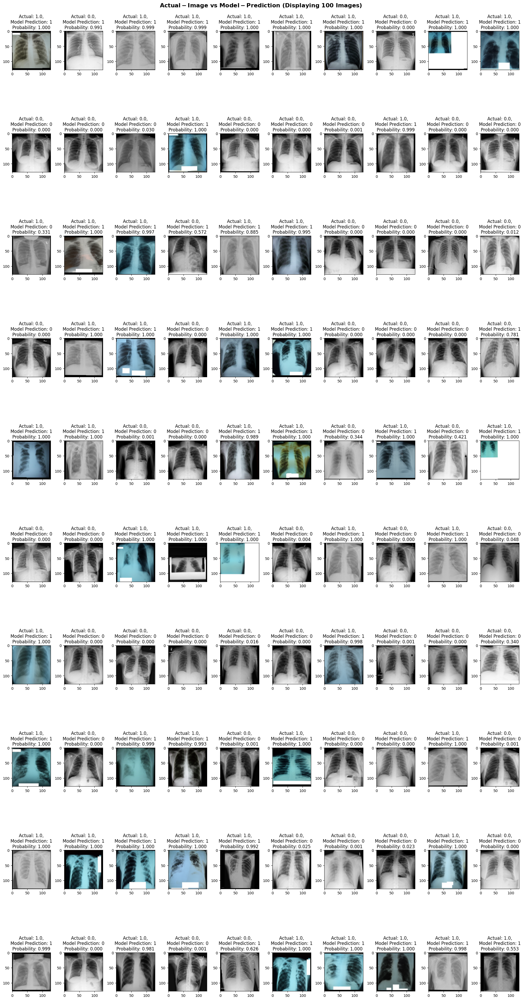

In [68]:
compare_actual_and_predicted_xray(
                estimator=model_1st,
                images=X_test,
                target=y_test, 
                title=None,
                num_display=100,
                num_cols=10, 
                random_mode=True)

#  Lung segmentation


In [69]:
from skimage.filters import threshold_otsu
from skimage.color import label2rgb
from skimage.morphology import closing, square
from skimage.measure import label, regionprops
from skimage.segmentation import clear_border

In [70]:
class ImageSegmentation:
    def __init__(self, input_shape):
        self.input_shape = input_shape

    def lung_segmentation(self, X):
        if X.shape != self.input_shape:
            X = X[:, :, 0]

        # Equalize the image with CLAHE
        X = exposure.equalize_adapthist(
            X, kernel_size=None, clip_limit=0.01, nbins=256)

        # Create a binary threshold mask and apply it to the image
        thresh = threshold_otsu(image=X, nbins=256, hist=None)
        thresh = X > thresh
        bw = closing(X > thresh, square(1))

        # Clean up the borders
        cleared = clear_border(bw)

        # Label image regions
        label_image = label(cleared)
        image_label_overlay = label2rgb(
            label_image,
            image=X,
            bg_label=0,
            bg_color=(0, 0, 0))

        return image_label_overlay, label_image

    def show_segmented_images(self,images, target, title, num_display=16, num_cols=4, cmap='gray', random_mode=False,only_segmented=True):
        '''
        :Parameters
            images (ndarray (n,)): Input data as a numpy array.
            target (ndarray (n,)): Target data as a numpy array.
            title (String): Title of the plot.
            num_display (int): Number of images to display. Default is 16.
            num_cols (int): Number of columns in the plot. Default is 4.
            cmap (str): Color map for displaying images. Default is 'gray'.
            random_mode (bool): If True, display images randomly. If False, display the first num_display images. Default is False.
        '''
        # Determine the number of rows based on the num_cols parameter
        n_cols = min(num_cols, num_display)
        n_rows = int(np.ceil(num_display / n_cols))

        n_images = min(num_display, len(images))
        if random_mode:
            random_indices = np.random.choice(
                len(images), num_display, replace=False)
        else:
            random_indices = np.arange(num_display)

        fig, axes = plt.subplots(
            nrows=n_rows, ncols=n_cols, figsize=(20, 4*n_rows))
        for i, ax in enumerate(axes.flatten()):
            if i >= n_images:  # Check if the index exceeds the available number of images
                break
            # Incase (Did PCA)
            index = random_indices[i]
            if len(images.shape) == 2:
                image = images[index].reshape((128, 128)).astype(int)
            else:
                image = images[index]

            image_label_overlay, label_image = self.lung_segmentation(
                image)
                
            ax.imshow(
                label_image if only_segmented else image_label_overlay, cmap=cmap)
            ax.set_title("Target: {}".format(target[index]))

            # Add image index as text
            ax.text(0.5, -0.15, f'Image Index: {index}', transform=ax.transAxes,
                    fontsize=10, ha='center')

        plt.suptitle(f"{title} (Displaying {num_display} Images)",
                    fontsize=16, fontweight='bold')

        fig.set_facecolor('white')
        plt.tight_layout()  # Added to ensure proper spacing between subplots
        return plt.show()


In [71]:
img_segmetator=ImageSegmentation(input_shape=(128,128))

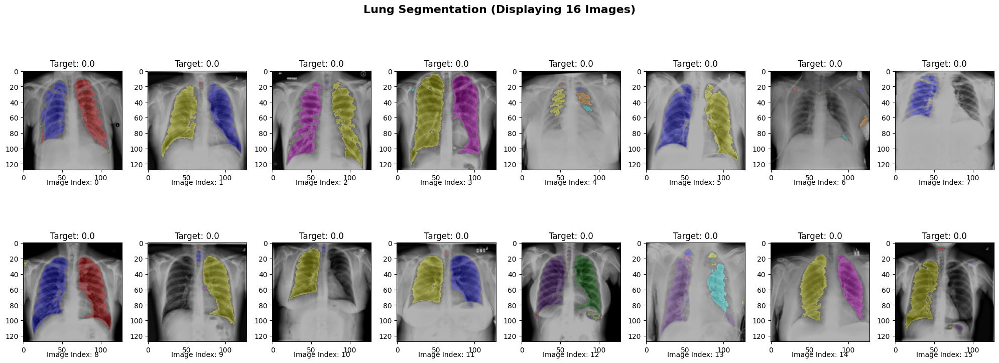

In [72]:
img_segmetator.show_segmented_images(images=X,
                                     target=y,
                                     num_display=16, num_cols=8,
                                     title='Lung Segmentation',
                                     cmap='binary',
                                     random_mode=False,
                                     only_segmented=False)

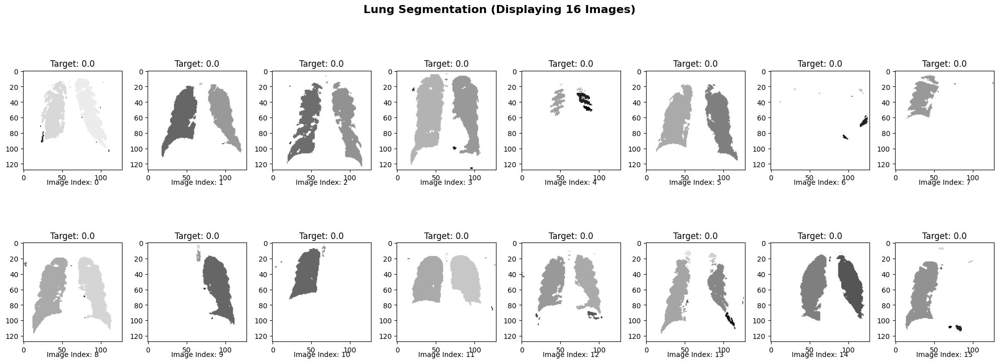

In [73]:
img_segmetator.show_segmented_images(images=X,
                                     target=y,
                                     num_display=16, num_cols=8,
                                     title='Lung Segmentation',
                                     cmap='binary',
                                     random_mode=False,
                                     only_segmented=True)

# Explainability
## Lime Library



In [74]:
# Lime
import lime
from lime.lime_image import LimeImageExplainer, ImageExplanation
# Ski
from skimage.segmentation import mark_boundaries
from skimage.color import gray2rgb
from skimage.transform import resize

import skimage.segmentation

# common
import numpy as np
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
import random

import cv2
import matplotlib.patches as mpatches
from skimage.filters import threshold_otsu
from skimage.exposure import equalize_adapthist
from skimage.color import label2rgb
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import square, closing
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.filters import sobel
from skimage.color import rgb2gray

class Explainer():
    def __init__(self, estimator, input_shape=None, threshold=None):
        self.estimator = estimator
        self.input_shape = input_shape

    def lime(self, X, y, top_labels, num_samples, num_features, class_names, num_display, method='slic', random_mode=False, cmap='gray'):
        '''
        Explain and visualize model predictions using LIME (Local Interpretable Model-Agnostic Explanations).

        Parameters:
            X (ndarray): Input data as a numpy array.
            y (ndarray): Target data as a numpy array.
            top_labels (int): Top coefficients to show (e.g., 1 for binary classification).
            num_samples (int): Number of perturbations to generate.
            num_features (int): Number of highlighted features (segmented areas) to extract.
            model (object): Trained machine learning model.
            class_names (list): List of class names.
            num_display (int): Number of images to display.
            random_mode (bool, optional): If True, display images randomly. Default is False.
            cmap (str, optional): Colormap for displaying images. Default is 'gray'.

        Returns:
            None

        This function explains and visualizes model predictions using LIME. It generates explanations for model predictions and displays them along with various image representations.

        Note:
        - The `X` input should have a shape like (num_images, width, height, channels) (e.g., (100, 128, 128, 1)).
        - The `class_names` list should contain class labels.
        - The function displays the explanations and does not return any values.
        '''

        # Model prediction
        
        y_hat = self.estimator.predict(X)
        prediction = (y_hat > 0.5).astype(int).flatten()

        n_cols = 5  # Display 5 images in each row

        title = r'$\bf{' + "Actual-Image" + '}$' + " vs " + \
            r'$\bf{' + "Model-Prediction" + '}$'

        n_images = min(num_display, len(X))

        if random_mode:
            random_indices = np.random.choice(
                len(X), num_display, replace=False)
        else:
            random_indices = np.arange(num_display)

        for i, idx in enumerate(random_indices):
            
            X_resized = tf.image.resize(X[idx], self.input_shape).numpy()
#             # Change to RBG for input in Lime
#             rgb_resized_image = cv2.cvtColor(X_resized, cv2.COLOR_GRAY2RGB)
            rgb_resized_image = X_resized
            explainer = LimeImageExplainer()

            def model_pred_fn(images):
                y_hat = self.estimator.predict(images)
                return y_hat
            
            def segment_fn(image):
                if method == 'felzenszwalb':
                    segments = felzenszwalb(image, scale=200, sigma=0.5, min_size=50)
                elif method == 'slic':
                    segments = slic(image, n_segments=50, compactness=10, sigma=1)
                elif method == 'quickshift':
                    segments = quickshift(image, kernel_size=2, max_dist=50, ratio=0.5)
                elif method == 'watershed':
                    gradient = sobel(rgb2gray(image))
                    segments = watershed(gradient, markers=50, compactness=0.001)
                elif method == 'lung_segmentation':
                    segments = self.lung_segmentation(image)
                else:
                    raise ValueError(
                        "Invalid segmentation method. Supported methods: 'felzenszwalb', 'slic', 'quickshift', 'watershed', 'lung_segmentation'")

                return segments

            explanation = explainer.explain_instance(
                rgb_resized_image,
                model_pred_fn,
                top_labels=top_labels,
                hide_color=0,
                num_samples=num_samples,
                segmentation_fn=segment_fn,
            )
            #  positive_only=True if prediction[idx] ==0  else False,
            temp, mask = explanation.get_image_and_mask(
                explanation.top_labels[0],
                positive_only=False,
                num_features=num_features,
                hide_rest=False,
                min_weight=0.0
                )

            # Create a figure with 1 row and 5 columns
            fig, axes = plt.subplots(1, n_cols, figsize=(30, 6))

            # Add a big header title above the subplots
            plt.suptitle(
                title, fontsize=16)

            # First axis: Actual Image
            axes[0].imshow(X_resized, cmap=cmap) 
            actual_title = r'$\bf{' + 'Actual' + '}$'
            actual_cls = class_names[int(y[idx])]

            model_title = r'$\bf{' + 'Model-Prediction' + '}$'
            model_cls = class_names[int(prediction[idx])]
            model_prob = '{:.9f}'.format(float(y_hat[idx]))
            axes[0].set_title(actual_title + '\nTarget: ' + actual_cls)

            image_label_overlay = label2rgb(
                segment_fn(rgb_resized_image),
                image=rgb_resized_image,
                bg_label=0,
                bg_color=(0, 0, 0))

            axes[1].imshow(X_resized, cmap=cmap)
            axes[1].imshow(image_label_overlay)

            axes[1].set_title(model_title + '\nTarget: ' + model_cls)

            axes[2].imshow(segment_fn(rgb_resized_image),cmap='binary')
            axes[2].set_title(
                r'$\bf{' + 'Segmentation' + '}$' + f'\nProbability: ' + model_prob)
            
            # Third axis: Explanation Image
            axes[3].imshow(mark_boundaries(
                rgb_resized_image, segment_fn(rgb_resized_image)))
            axes[3].set_title(
                r'$\bf{' + 'LIME-Explanation' + '}$' + f'\nnumber of segments: {len(np.unique(segment_fn(rgb_resized_image)))}')
            temp, mask = explanation.get_image_and_mask(
                0,
                positive_only=True if prediction[idx] == 0 else False,
                num_features=num_features,
                hide_rest=False,
                min_weight=0.0
            )
            # Third axis: Explanation Image
            axes[4].imshow(mark_boundaries(
                temp, mask))
            axes[4].set_title(
                r'$\bf{' + 'LIME-Explanation' + '}$' + f'\nPositive and Negative regions')

            # Add the image index text
            plt.text(0.5, -0.15, f'Image Index: {idx}', transform=axes[0].transAxes,
                     fontsize=10, ha='center')

            plt.tight_layout()

            plt.show()

    def diff_sementation(self, X):
        # Generate a random sample index
        sample_index = random.randint(0, X.shape[0] - 1)

#         # Get the single grayscale sample
#         grayscale_sample = X[sample_index]

#         # Convert to RGB by repeating the single channel along the third axis
#         img = np.repeat(grayscale_sample, 3, axis=2)

        segments_fz = felzenszwalb(img, scale=200, sigma=0.5, min_size=50)
        segments_slic = slic(img, n_segments=50, compactness=10, sigma=1)
        segments_quick = quickshift(img, kernel_size=2, max_dist=50, ratio=0.5)
        gradient = sobel(rgb2gray(img))
        segments_watershed = watershed(gradient, markers=50, compactness=0.001)
        segments_equalize_adapthist = self.lung_segmentation(img)

        fig, ax = plt.subplots(1, 5, figsize=(30, 6))

        ax[0].imshow(mark_boundaries(img, segments_fz))
        ax[0].set_title("Felzenszwalbs's method")
        ax[0].text(
            0.5, -0.05, f"number of segments: {len(np.unique(segments_fz))}", transform=ax[0].transAxes, ha='center')

        ax[1].imshow(mark_boundaries(img, segments_slic))
        ax[1].set_title('SLIC')
        ax[1].text(
            0.5, -0.05, f"number of segments: {len(np.unique(segments_slic))}", transform=ax[1].transAxes, ha='center')

        ax[2].imshow(mark_boundaries(img, segments_quick))
        ax[2].set_title('Quickshift')
        ax[2].text(
            0.5, -0.05, f"number of segments: {len(np.unique(segments_quick))}", transform=ax[2].transAxes, ha='center')

        ax[3].imshow(mark_boundaries(img, segments_watershed))
        ax[3].set_title('Compact watershed')
        ax[3].text(
            0.5, -0.05, f"number of segments: {len(np.unique(segments_watershed))}", transform=ax[3].transAxes, ha='center')
        ax[4].imshow(mark_boundaries(img, segments_equalize_adapthist))
        ax[4].set_title('lung_segmentation')
        ax[4].text(
            0.5, -0.05, f"number of segments: {len(np.unique(segments_equalize_adapthist))}", transform=ax[4].transAxes, ha='center')

        for a in ax.ravel():
            a.set_axis_off()

        plt.tight_layout()
        plt.show()

    def lung_segmentation(self, X):
        # Single of exmaple
        X = X[:, :, 0]

        # Even out the contrast with CLAHE
        X_equalized = equalize_adapthist(
            X, kernel_size=None, clip_limit=0.05, nbins=256)

        # Make a binary threshold mask and apply it to the image
        thresh = threshold_otsu(image=X_equalized, nbins=256, hist=None)
        thresh = X_equalized > thresh
        bw = closing(X_equalized > thresh, square(1))

        # Clean up the borders
        cleared = clear_border(bw)

        # Label image regions
        label_image = label(cleared)
        

        return label_image


In [75]:
explnr = Explainer(estimator=model_1st, input_shape=(128, 128))

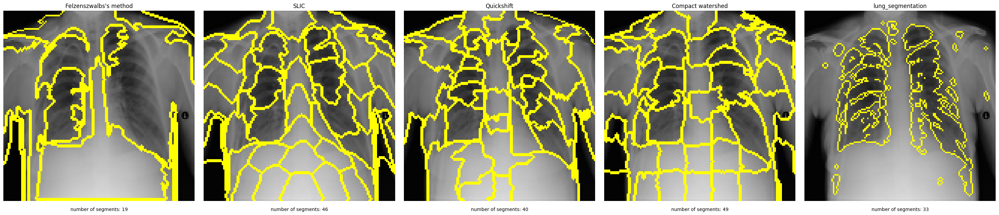

In [76]:
explnr.diff_sementation(X=X_test)

In [77]:
model_1st.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 128, 128, 1)       28        
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 64, 64, 1)         0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 64, 64, 3)         30        
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 32, 32, 3)         0         
 g2D)                                                            
                                                                 
 conv2d_8 (Conv2D)           (None, 32, 32, 6)         168       
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 16, 16, 6)        

22/22 [==============================] - 1s 40ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


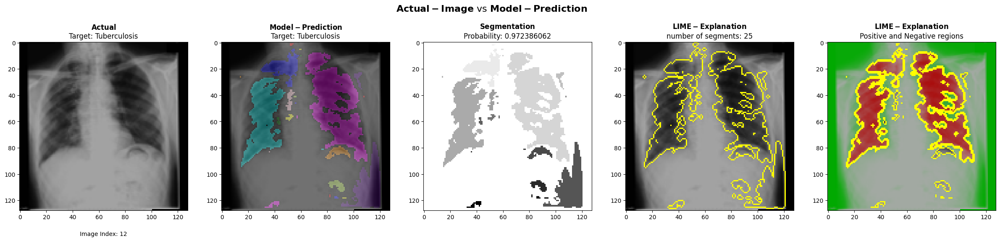

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 45ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


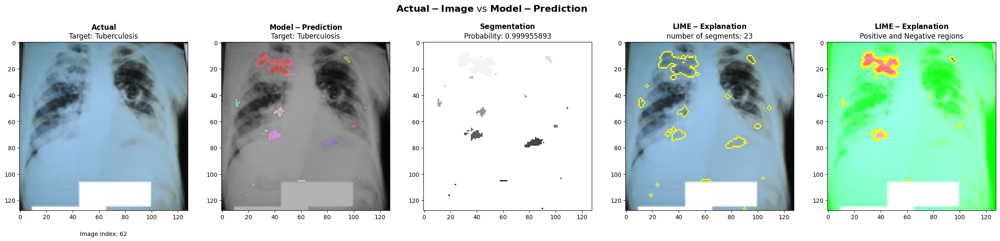

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


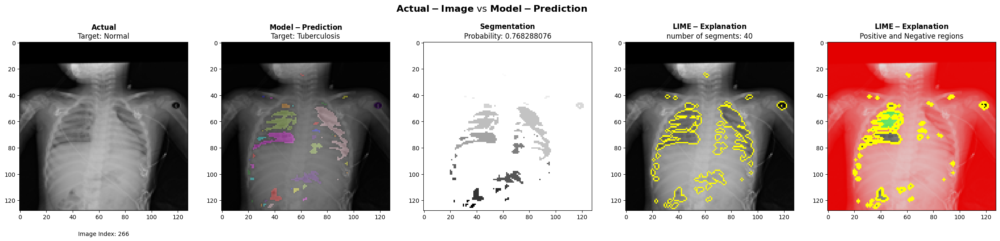

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 45ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


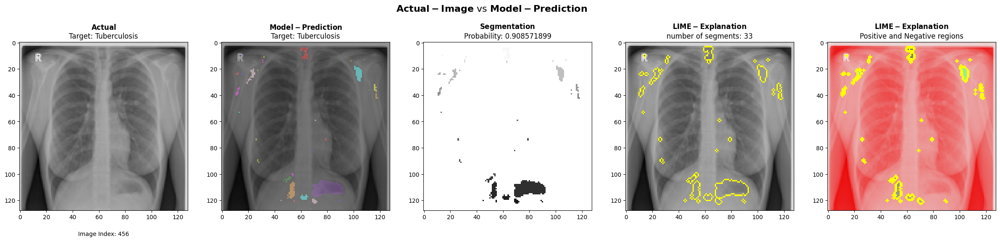

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


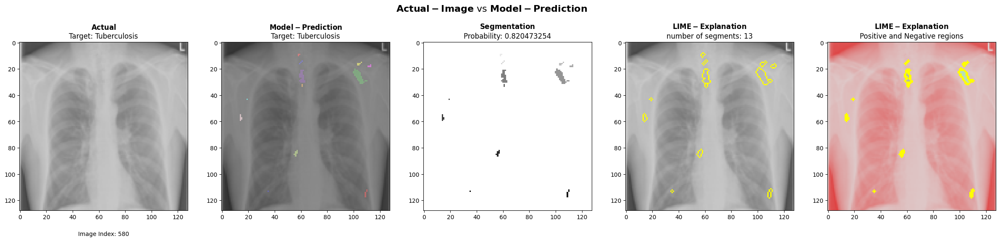

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 38ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


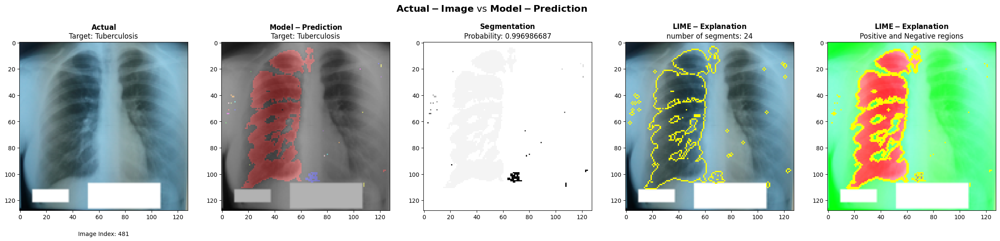

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


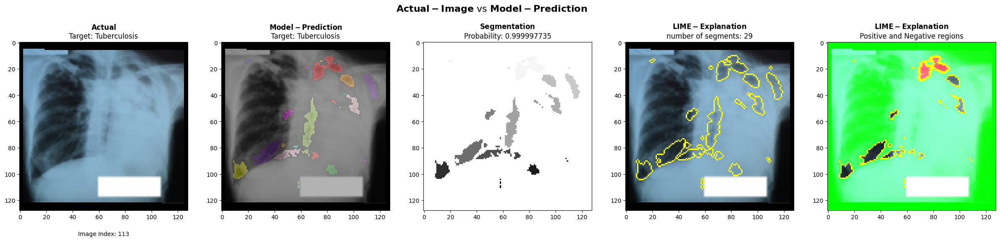

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 44ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


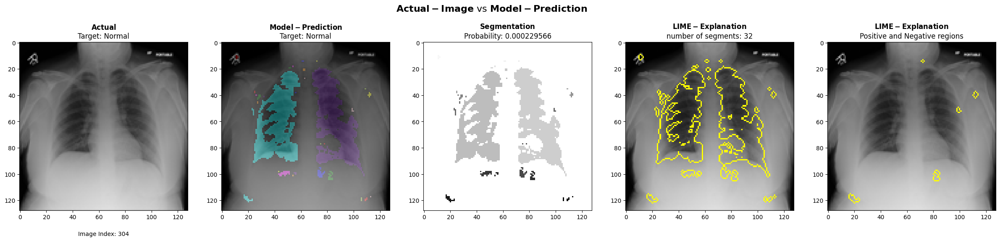

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 41ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


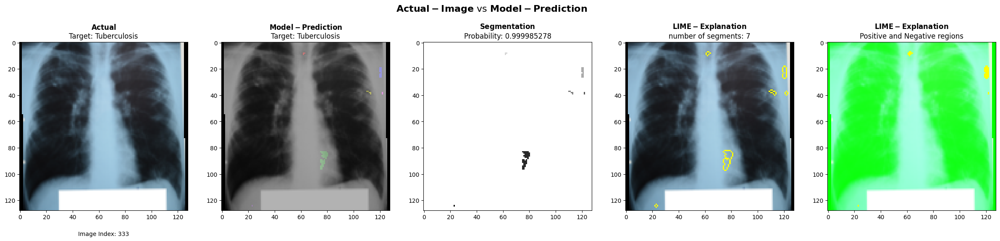

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 41ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


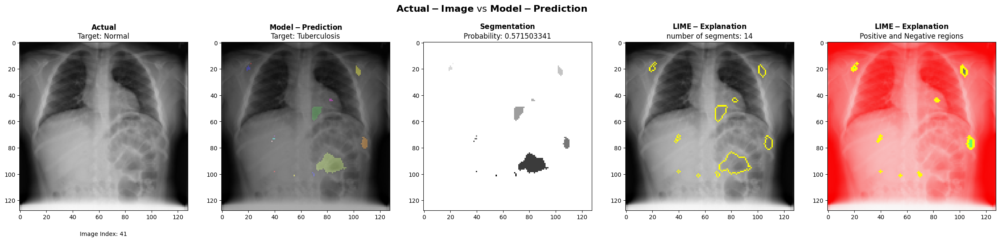

In [78]:
explnr.lime(X=X_test,
            y=y_test,
            top_labels=1,
            num_samples=1000,
            num_features=5,
            class_names=['Normal', 'Tuberculosis'],
            num_display=10,
            method='lung_segmentation',
            random_mode=True,
            cmap='gray'
            )


22/22 [==============================] - 1s 42ms/step


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 51ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


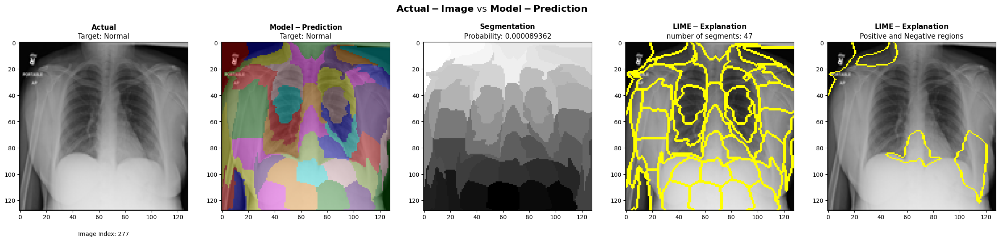

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 43ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


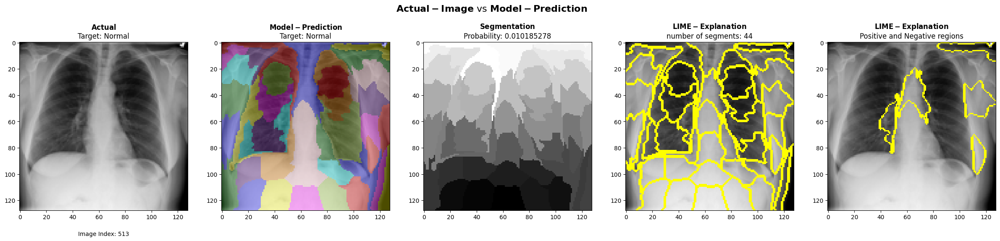

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


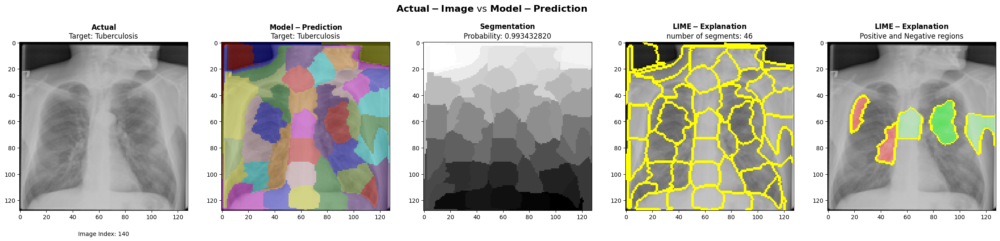

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 46ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


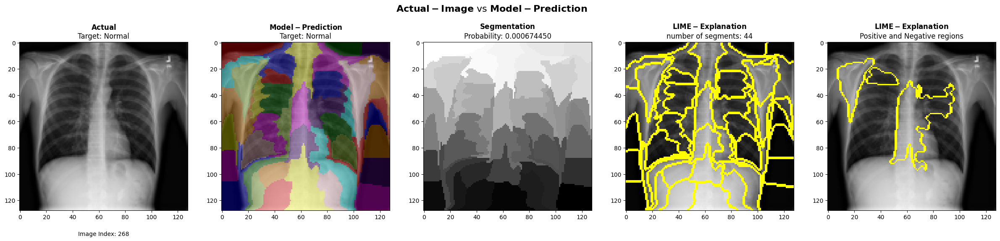

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


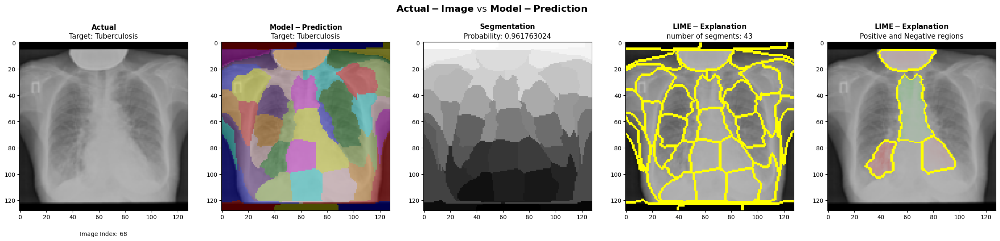

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


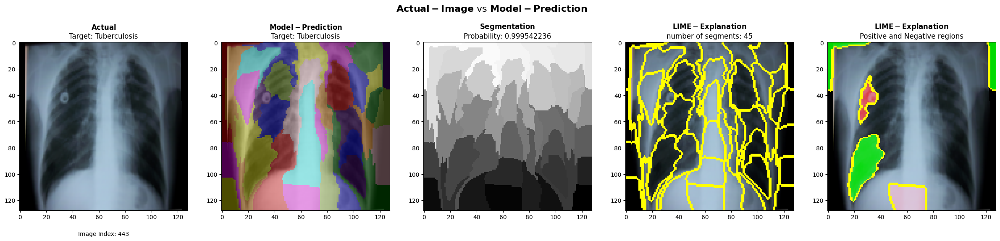

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


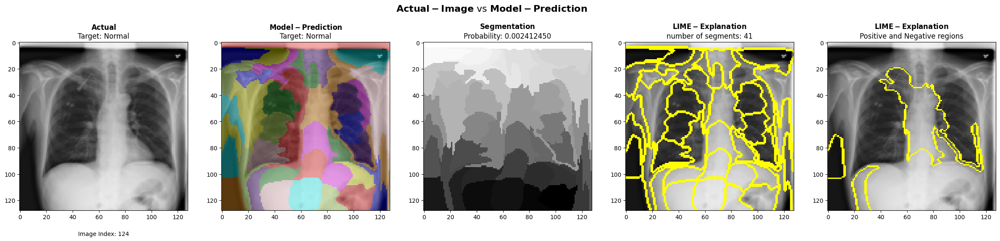

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 49ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


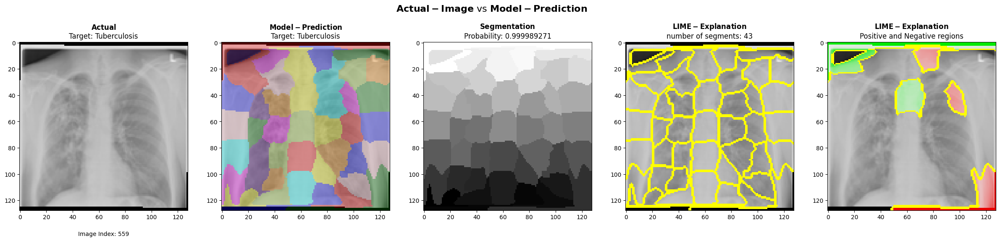

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 44ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


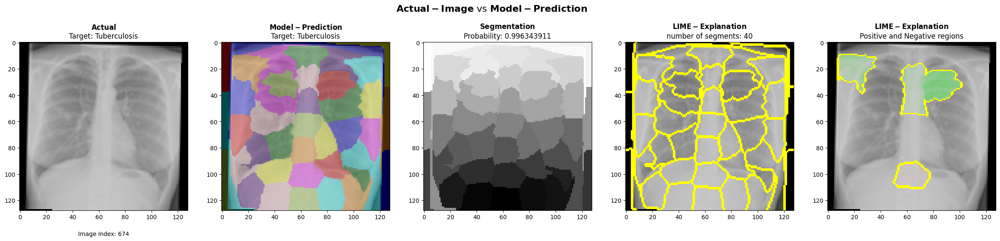

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


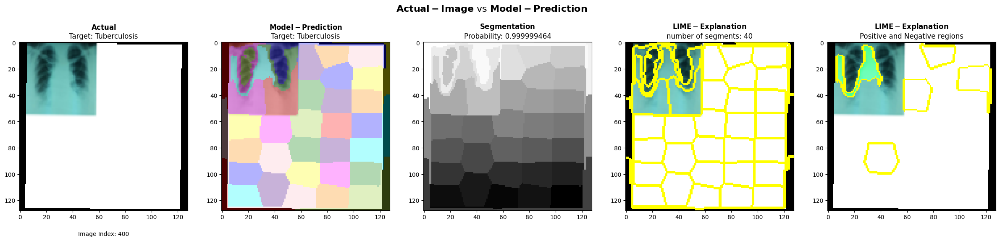

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 45ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


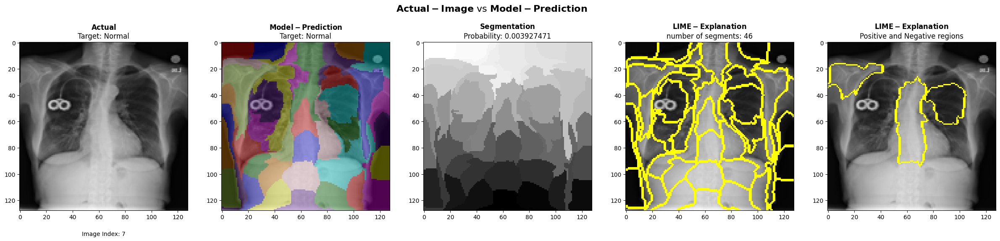

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 41ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


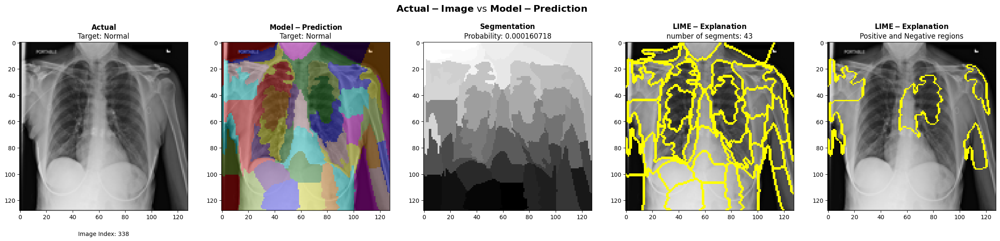

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


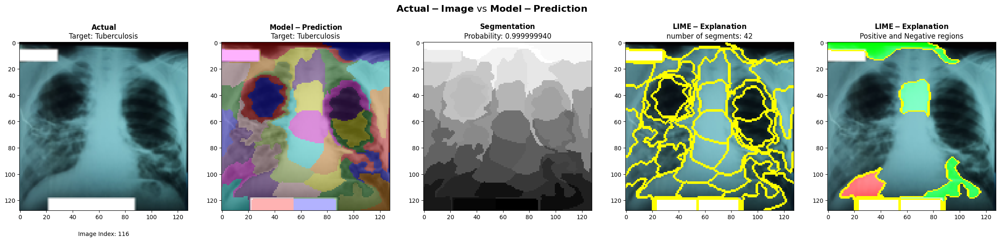

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


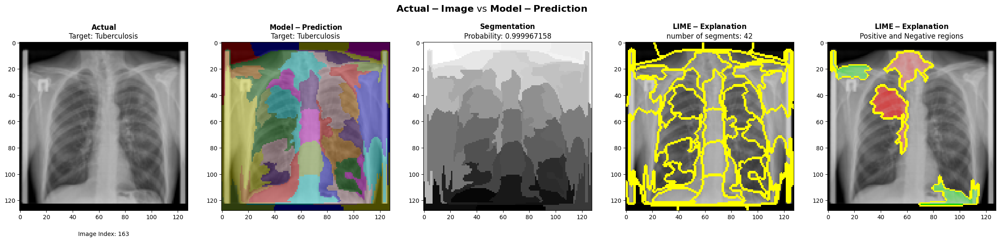

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 44ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


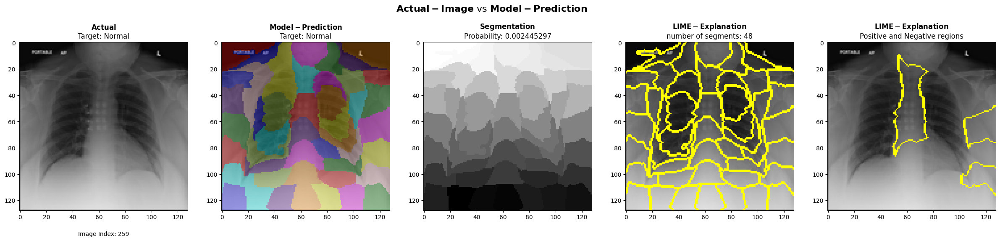

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


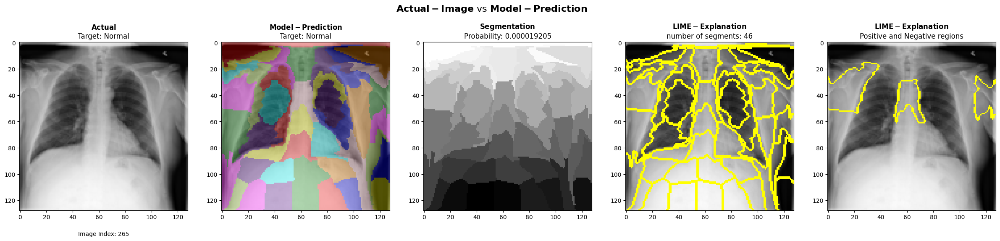

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


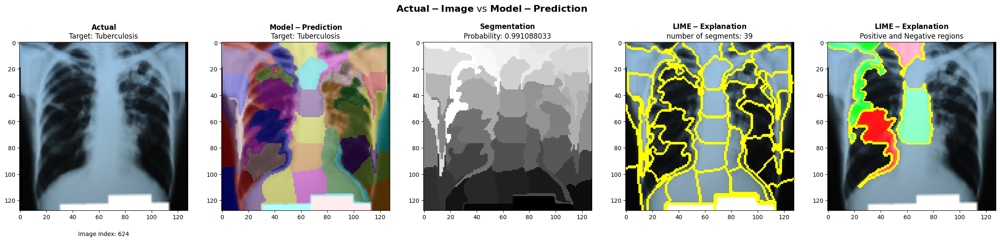

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


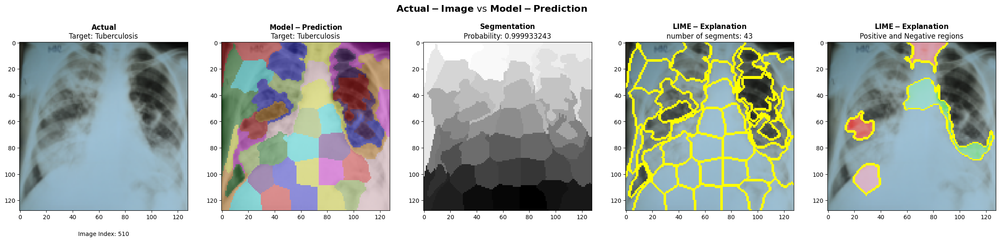

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


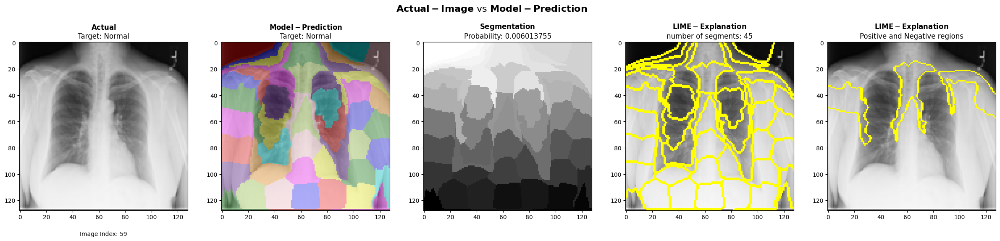

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 43ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


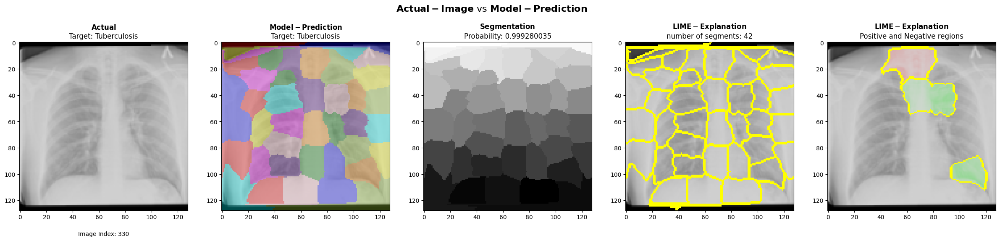

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


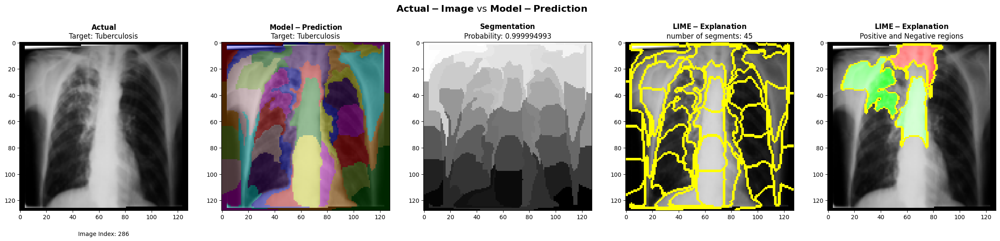

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


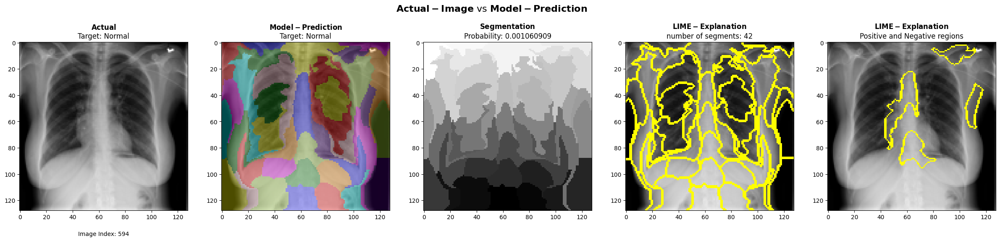

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


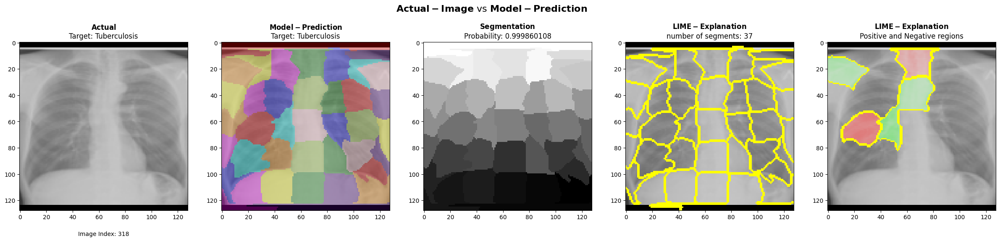

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


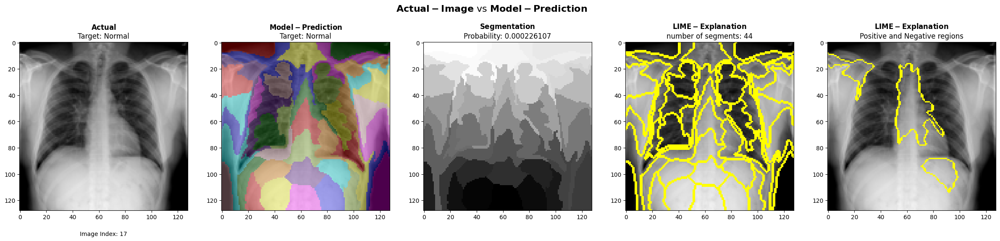

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 49ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


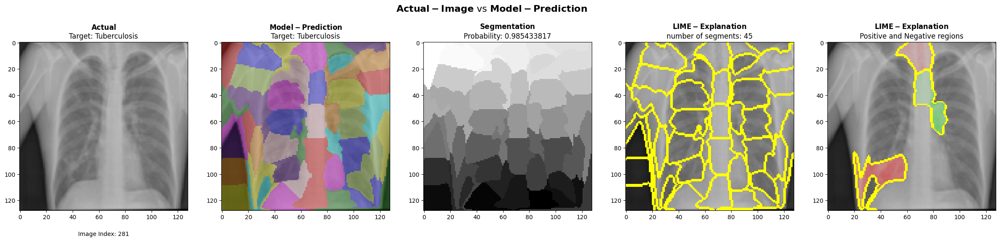

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 39ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


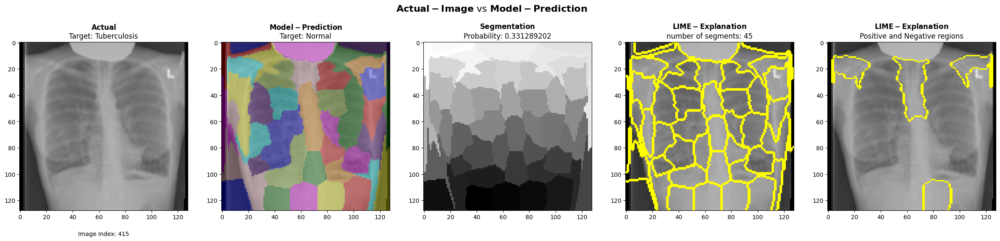

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


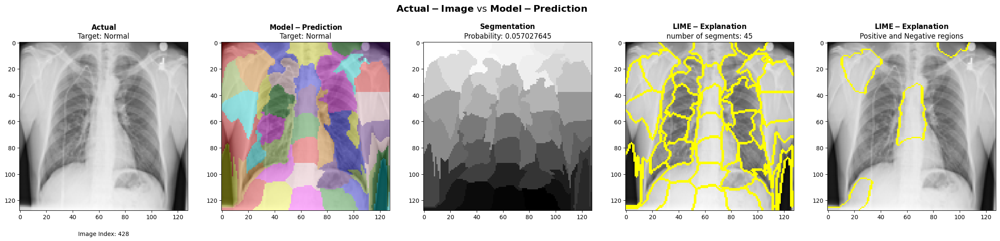

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 46ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


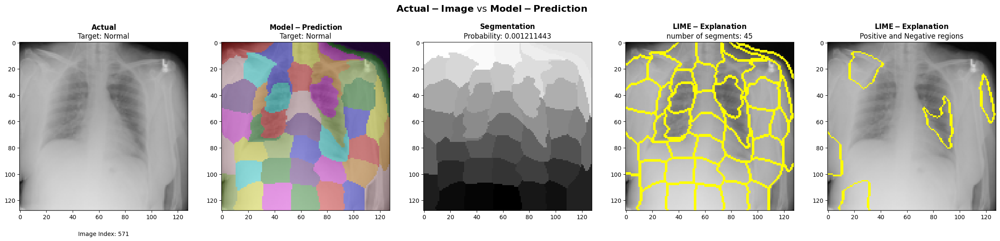

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 62ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


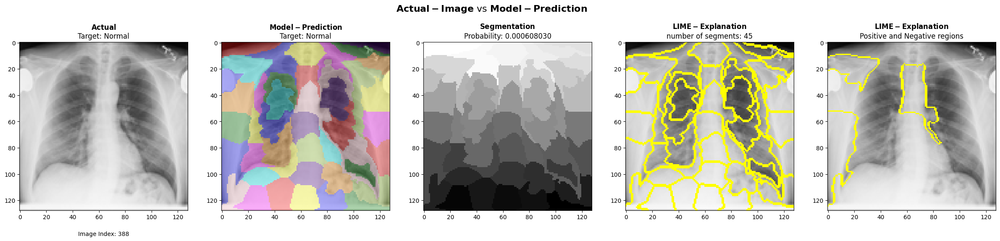

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 46ms/step


/tmp/ipykernel_20/2985811535.py:181: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


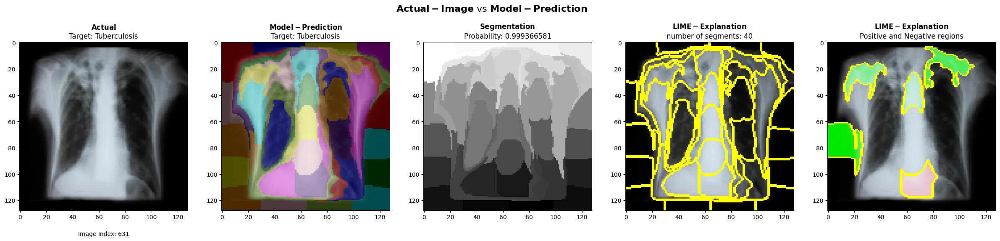

In [79]:
explnr.lime(X=X_test,
            y=y_test,
            top_labels=1,
            num_samples=100,
            num_features=5,
            class_names=['Normal', 'Tuberculosis'],
            num_display=30,
            method='slic',
            random_mode=True,
            cmap='gray')